### Loading Packages and Data

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 8)

#import xarray as xr
import warnings
warnings.filterwarnings('ignore')
from matplotlib.backends.backend_pdf import PdfPages

from db_queries import get_outputs as go
from db_queries import get_ids
from get_draws.api import get_draws

In [2]:
ls /mnt/team/simulation_science/priv/engineering/vivarium_nih_us_cvd/19_adjusting_therapeutic_inertia/alabama/2023_08_02_12_11_17/count_data

deaths.csv                       sbp_medication_person_time.csv
deaths.hdf                       sbp_medication_person_time.hdf
healthcare_visits.csv            state_person_time.csv
healthcare_visits.hdf            state_person_time.hdf
intervention_person_time.csv     transition_count.csv
intervention_person_time.hdf     transition_count.hdf
ldlc_medication_person_time.csv  ylds.csv
ldlc_medication_person_time.hdf  ylds.hdf
risk_exposure_time.csv           ylls.csv
risk_exposure_time.hdf           ylls.hdf


In [3]:
sim_results_dir = '/mnt/team/simulation_science/priv/engineering/vivarium_nih_us_cvd/19_adjusting_therapeutic_inertia/alabama/2023_08_02_12_11_17/count_data'

## Checking Stability of Risks over Time

In [4]:
state_person_time = pd.read_csv(sim_results_dir + '/state_person_time.csv')
person_time = state_person_time.loc[state_person_time['state'].isin(["acute_ischemic_stroke", "chronic_ischemic_stroke", "susceptible_to_ischemic_stroke"])].reset_index() 
person_time = person_time.rename(columns = {'value':'ptvalue'})
per_time_group = person_time.groupby(['age', 'sex', 'year','input_draw','scenario']).ptvalue.sum().reset_index()
per_time_group.head()

,age,sex,year,input_draw,scenario,ptvalue
0,25_to_29,Female,2021,29,baseline,1944.323066
1,25_to_29,Female,2021,29,lifestyle_100,1944.323066
2,25_to_29,Female,2021,29,outreach_100,1944.323066
3,25_to_29,Female,2021,29,polypill_100,1944.323066
4,25_to_29,Female,2021,232,baseline,1957.815195


### BMI

In [8]:
risk_exp = pd.read_csv(sim_results_dir + '/risk_exposure_time.csv')
risk_exp.head()

,Unnamed: 0,sex,year,risk,measure,input_draw,scenario,age,value
0,0,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,baseline,25_to_29,60096.643279
1,1,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,lifestyle_100,25_to_29,60096.643279
2,2,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,outreach_100,25_to_29,60096.643279
3,3,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,polypill_100,25_to_29,60096.643279
4,4,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,baseline,30_to_34,58877.884622


In [9]:
bmi_exp = risk_exp.loc[risk_exp['risk']=='high_body_mass_index_in_adults']
bmi_exp.head()

,Unnamed: 0,sex,year,risk,measure,input_draw,scenario,age,value
0,0,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,baseline,25_to_29,60096.643279
1,1,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,lifestyle_100,25_to_29,60096.643279
2,2,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,outreach_100,25_to_29,60096.643279
3,3,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,polypill_100,25_to_29,60096.643279
4,4,Female,2021,high_body_mass_index_in_adults,risk_exposure_time,29,baseline,30_to_34,58877.884622


In [10]:
bmi_exp_rate = bmi_exp.groupby(['age','sex','year','input_draw','scenario']).value.sum().reset_index()
bmi_exp_rate = bmi_exp_rate.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue']],on=['age','sex','year','input_draw','scenario'])
#bmi_exp_rate = pd.concat([bmi_exp_rate, per_time_group.ptvalue], axis=1)
bmi_exp_rate['bmi_rate'] = bmi_exp_rate['value'] / bmi_exp_rate['ptvalue']
bmi_exp_rate_summ = (bmi_exp_rate
                .groupby(['age', 'sex', 'year','scenario'])
                .bmi_rate.describe(percentiles=[.025,0.5, .975])
                .filter(['mean', '50%','2.5%', '97.5%'])
                .reset_index())
bmi_exp_rate_summ.head()

,age,sex,year,scenario,mean,50%,2.5%,97.5%
0,25_to_29,Female,2021,baseline,30.766584,30.785494,30.228202,31.231628
1,25_to_29,Female,2021,lifestyle_100,30.766584,30.785494,30.228202,31.231628
2,25_to_29,Female,2021,outreach_100,30.766584,30.785494,30.228202,31.231628
3,25_to_29,Female,2021,polypill_100,30.766584,30.785494,30.228202,31.231628
4,25_to_29,Female,2022,baseline,30.736577,30.738641,30.309761,31.198048


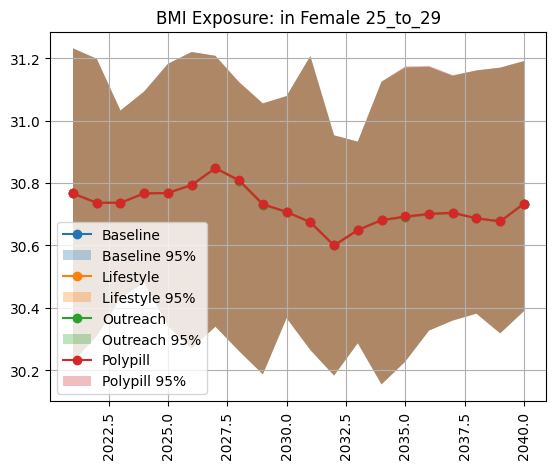

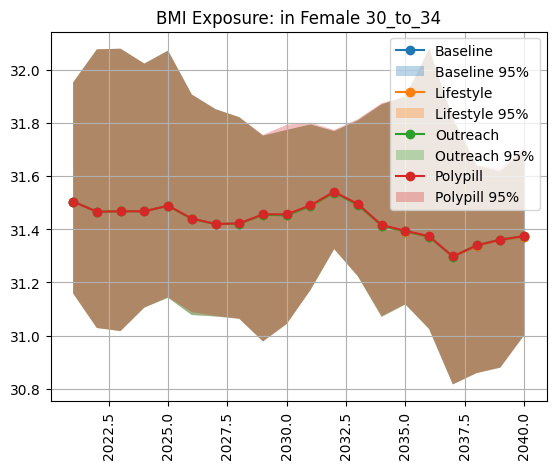

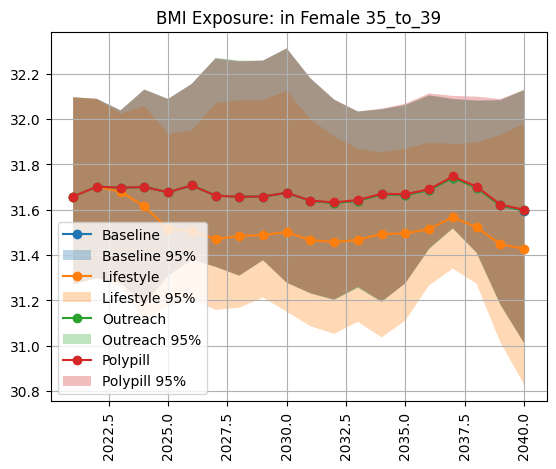

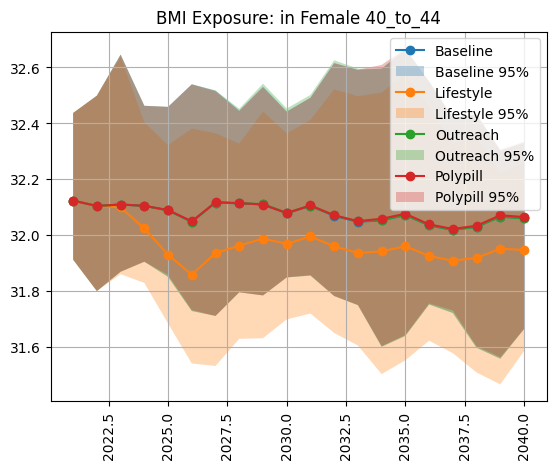

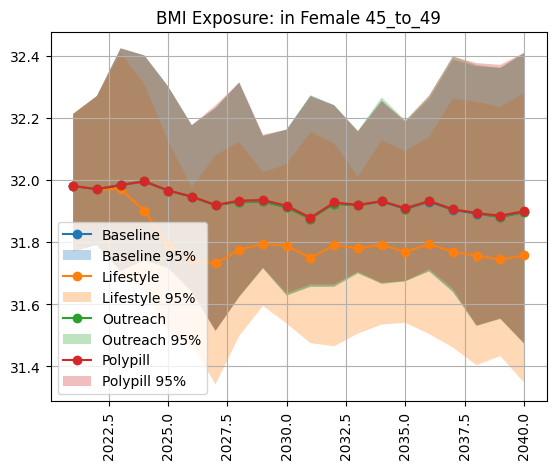

...

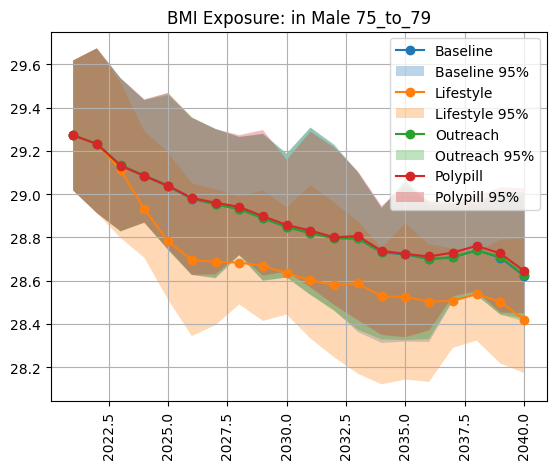

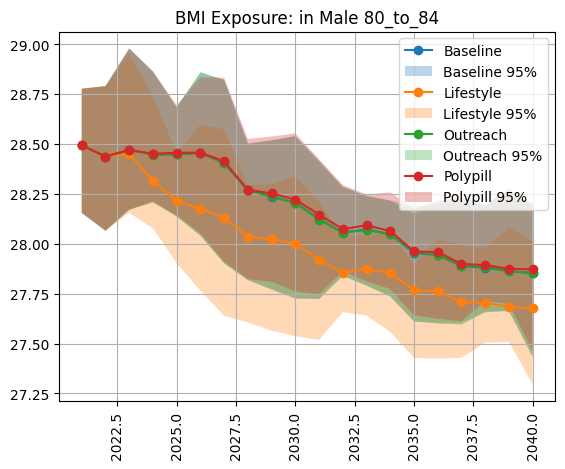

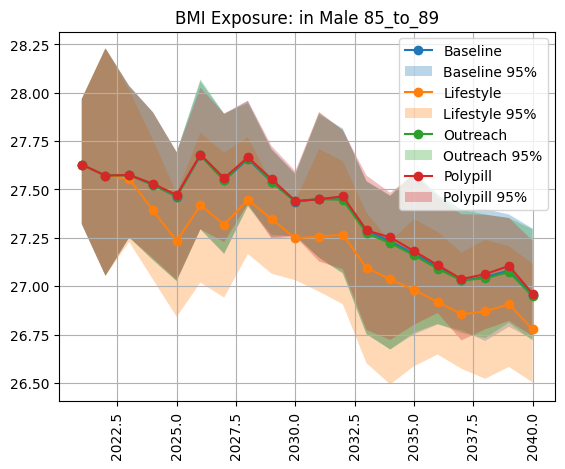

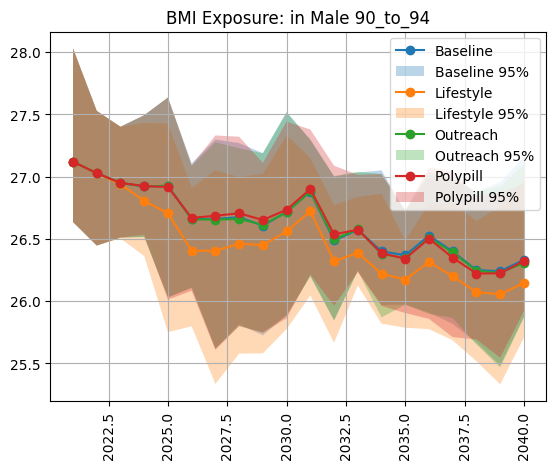

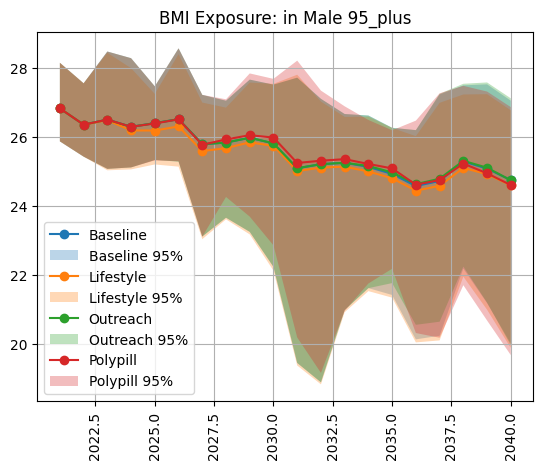

In [11]:
#%%capture
for sex in bmi_exp_rate_summ.sex.unique():
    for age in bmi_exp_rate_summ.age.unique():
        plt.figure() 
        subdata = bmi_exp_rate_summ.loc[(bmi_exp_rate_summ.sex==sex) & (bmi_exp_rate_summ.age==age) & (bmi_exp_rate_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = bmi_exp_rate_summ.loc[(bmi_exp_rate_summ.sex==sex) & (bmi_exp_rate_summ.age==age) & (bmi_exp_rate_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = bmi_exp_rate_summ.loc[(bmi_exp_rate_summ.sex==sex) & (bmi_exp_rate_summ.age==age) & (bmi_exp_rate_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = bmi_exp_rate_summ.loc[(bmi_exp_rate_summ.sex==sex) & (bmi_exp_rate_summ.age==age) & (bmi_exp_rate_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        plt.legend(['Baseline','Baseline 95%','Lifestyle','Lifestyle 95%','Outreach','Outreach 95%','Polypill','Polypill 95%'])
        plt.title(f'BMI Exposure: in {sex} {age}') 
        plt.xticks(rotation=90) 
        #plt.ylim(20,33)
        plt.grid()

As expected, lifestyle is the only scenario with a real change in BMI. This is good as it is the only one that directly affects BMI and nothing is correlated yet! 

### SBP 

In [13]:
sbp_exp = risk_exp.loc[risk_exp['risk']=='high_systolic_blood_pressure']
sbp_exp_rate = sbp_exp.groupby(['age','sex','year','input_draw','scenario']).value.sum().reset_index()
sbp_exp_rate = pd.concat([sbp_exp_rate, per_time_group.ptvalue], axis=1)
sbp_exp_rate['sbp_rate'] = sbp_exp_rate['value'] / sbp_exp_rate['ptvalue']
sbp_exp_rate_summ = (sbp_exp_rate
                .groupby(['age', 'sex', 'year','scenario'])
                .sbp_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
sbp_exp_rate_summ.head()

,age,sex,year,scenario,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,110.116558,107.939709,113.099445
1,25_to_29,Female,2021,lifestyle_100,110.116558,107.939709,113.099445
2,25_to_29,Female,2021,outreach_100,110.116558,107.939709,113.099445
3,25_to_29,Female,2021,polypill_100,110.116558,107.939709,113.099445
4,25_to_29,Female,2022,baseline,110.039983,107.970342,113.081373


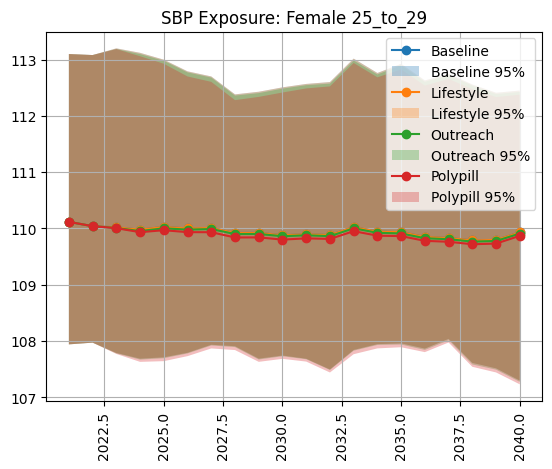

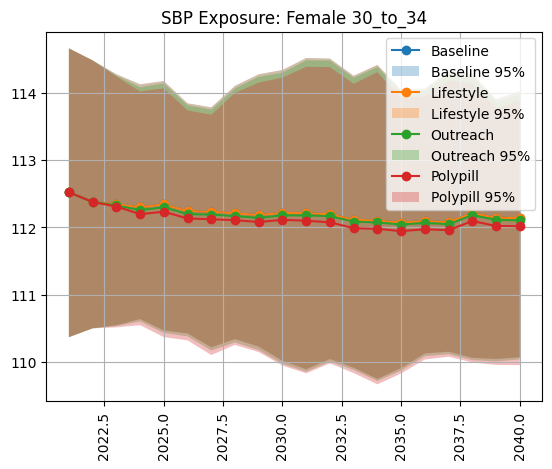

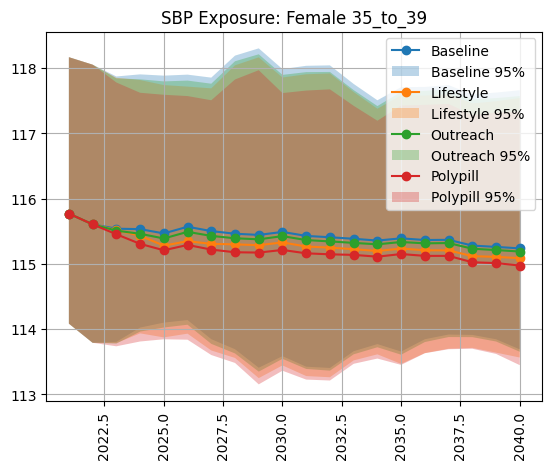

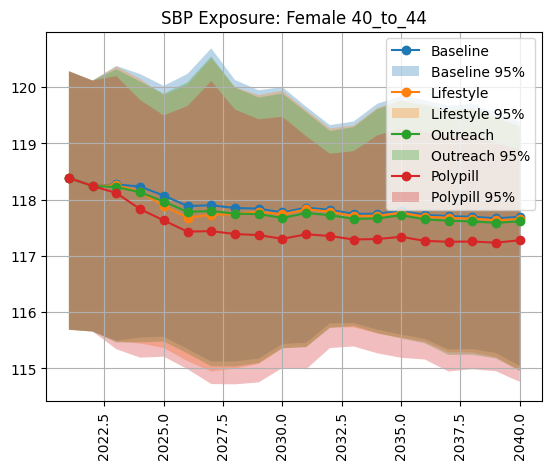

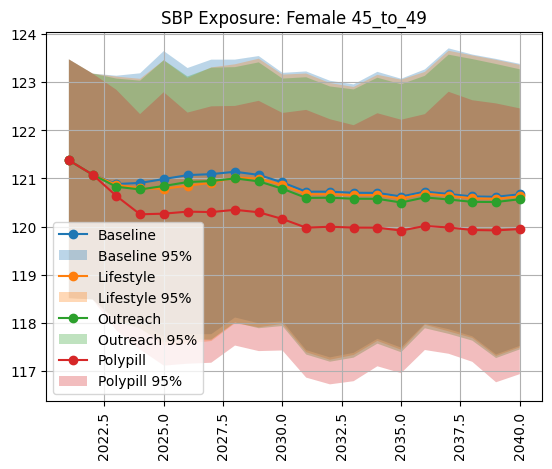

...

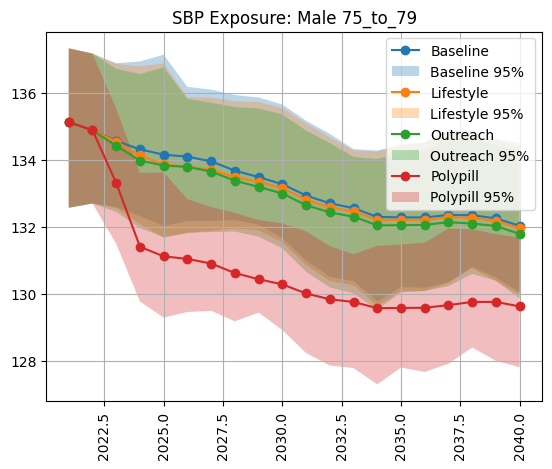

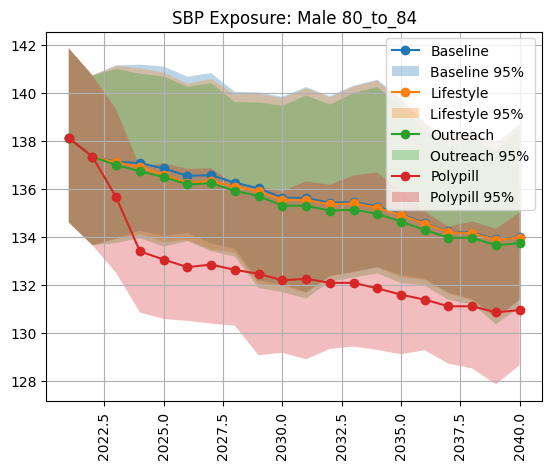

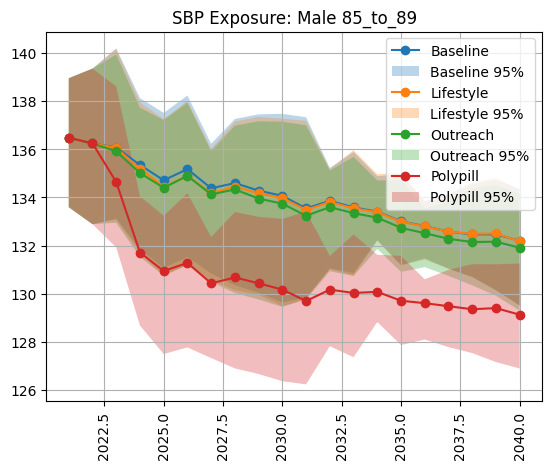

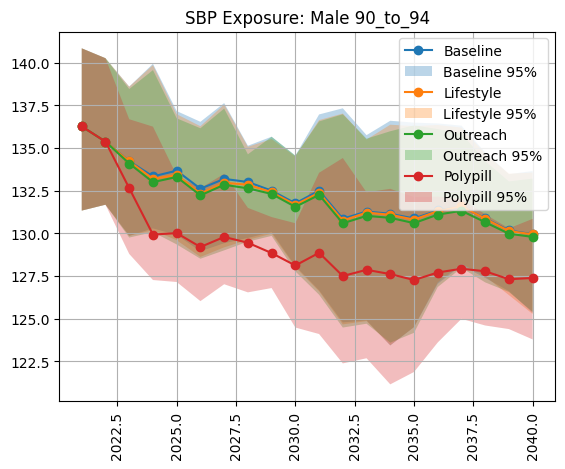

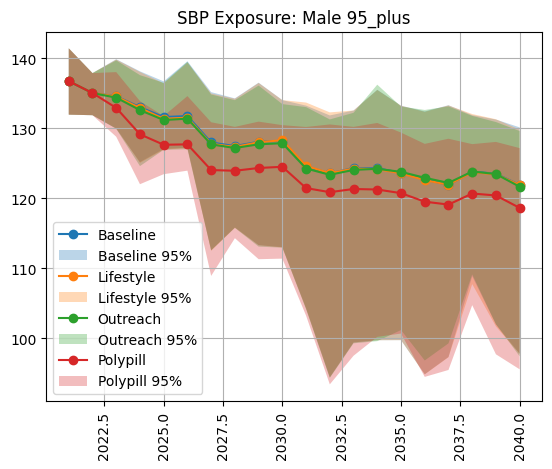

In [15]:
#%%capture
for sex in sbp_exp_rate_summ.sex.unique():
    for age in sbp_exp_rate_summ.age.unique():
        plt.figure() 
        subdata = sbp_exp_rate_summ.loc[(sbp_exp_rate_summ.sex==sex) & (sbp_exp_rate_summ.age==age) & (sbp_exp_rate_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = sbp_exp_rate_summ.loc[(sbp_exp_rate_summ.sex==sex) & (sbp_exp_rate_summ.age==age) & (sbp_exp_rate_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = sbp_exp_rate_summ.loc[(sbp_exp_rate_summ.sex==sex) & (sbp_exp_rate_summ.age==age) & (sbp_exp_rate_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = sbp_exp_rate_summ.loc[(sbp_exp_rate_summ.sex==sex) & (sbp_exp_rate_summ.age==age) & (sbp_exp_rate_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        plt.legend(['Baseline','Baseline 95%','Lifestyle','Lifestyle 95%','Outreach','Outreach 95%','Polypill','Polypill 95%'])
        plt.title(f'SBP Exposure: {sex} {age}') 
        plt.xticks(rotation=90) 
        #plt.ylim(0,100000)
        plt.grid()

Polypill and outreach have a visible impact on SBP as expected. Lifestyle has a slight effect as expected. 

### LDL-C

In [16]:
ldl_exp = risk_exp.loc[risk_exp['risk']=='high_ldl_cholesterol']
ldl_exp_rate = ldl_exp.groupby(['age','sex','year','input_draw','scenario']).value.sum().reset_index()
ldl_exp_rate = pd.concat([ldl_exp_rate, per_time_group.ptvalue], axis=1)
ldl_exp_rate['ldl_rate'] = ldl_exp_rate['value'] / ldl_exp_rate['ptvalue']
ldl_exp_rate_summ = (ldl_exp_rate
                .groupby(['age', 'sex', 'year','scenario'])
                .ldl_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
ldl_exp_rate_summ.head()

,age,sex,year,scenario,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,2.631480,2.553904,2.807301
1,25_to_29,Female,2021,lifestyle_100,2.631480,2.553904,2.807301
2,25_to_29,Female,2021,outreach_100,2.631480,2.553904,2.807301
3,25_to_29,Female,2021,polypill_100,2.631480,2.553904,2.807301
4,25_to_29,Female,2022,baseline,2.624722,2.543039,2.785793


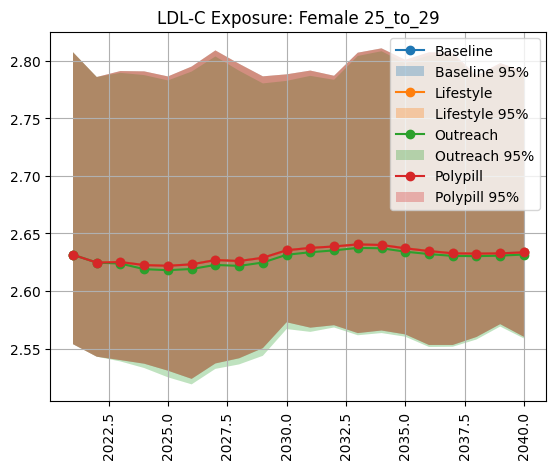

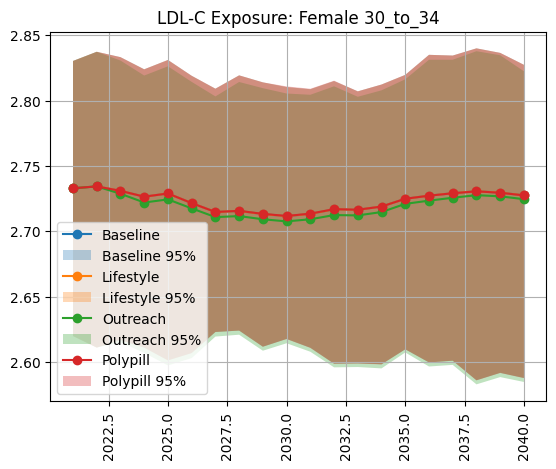

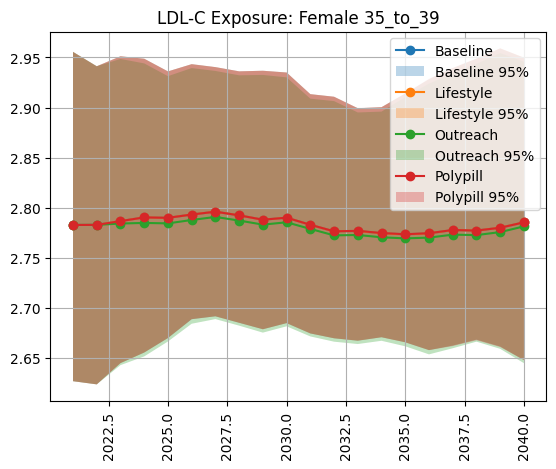

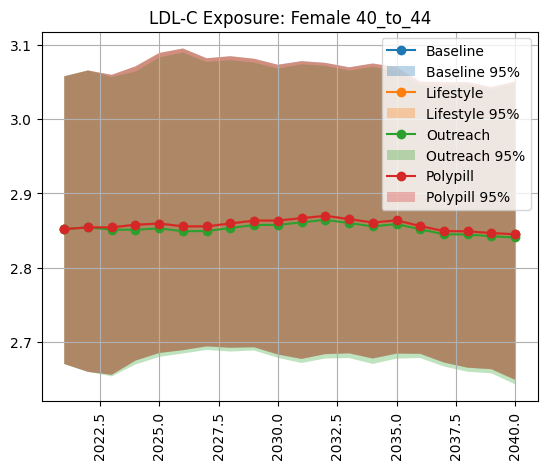

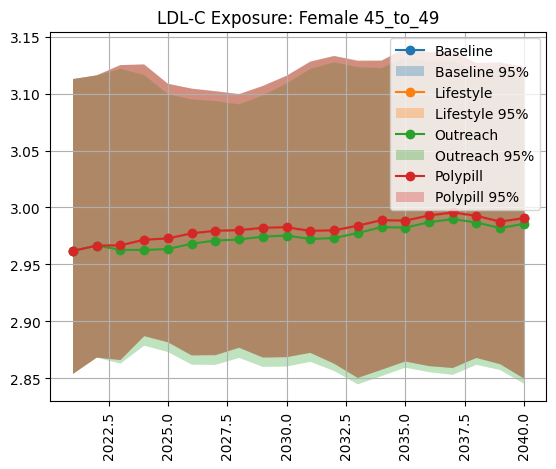

...

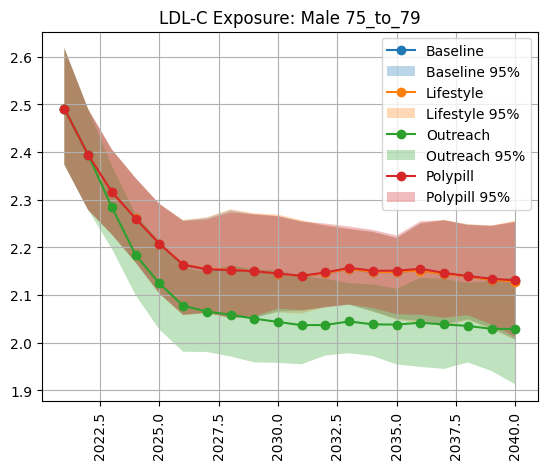

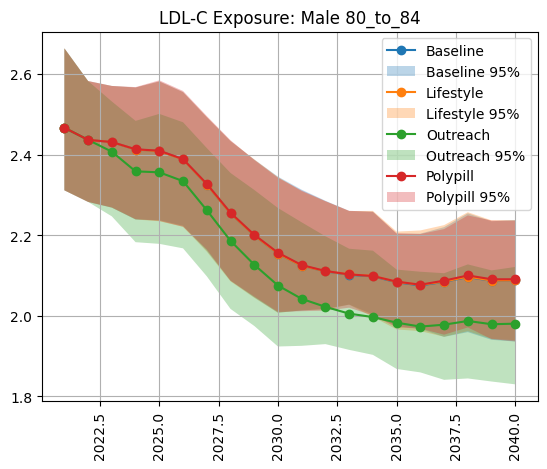

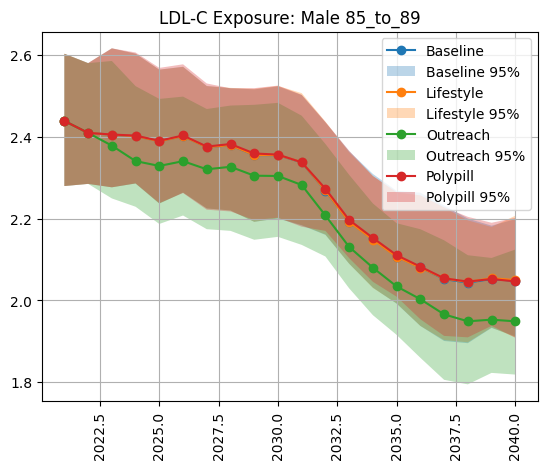

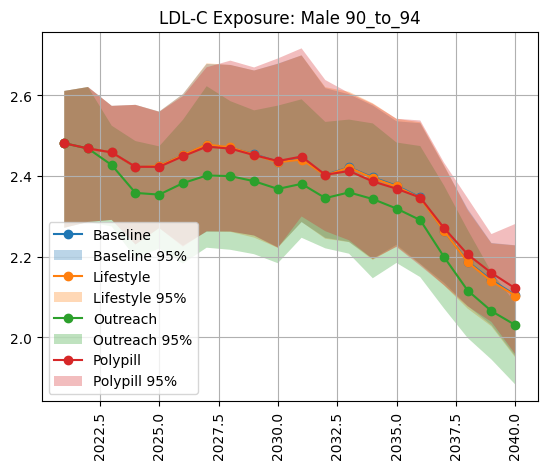

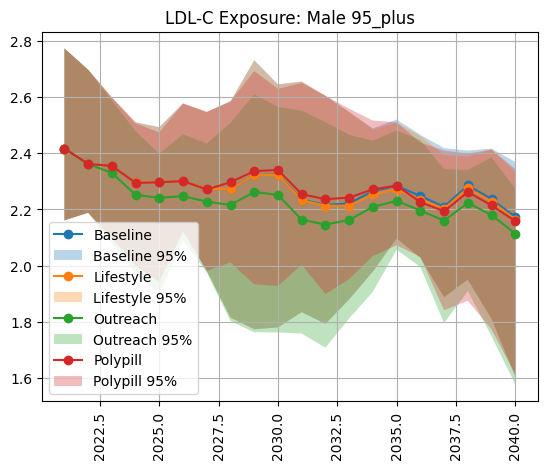

In [18]:
#%%capture
for sex in ldl_exp_rate_summ.sex.unique():
    for age in ldl_exp_rate_summ.age.unique():
        plt.figure() 
        subdata = ldl_exp_rate_summ.loc[(ldl_exp_rate_summ.sex==sex) & (ldl_exp_rate_summ.age==age) & (ldl_exp_rate_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = ldl_exp_rate_summ.loc[(ldl_exp_rate_summ.sex==sex) & (ldl_exp_rate_summ.age==age) & (ldl_exp_rate_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = ldl_exp_rate_summ.loc[(ldl_exp_rate_summ.sex==sex) & (ldl_exp_rate_summ.age==age) & (ldl_exp_rate_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = ldl_exp_rate_summ.loc[(ldl_exp_rate_summ.sex==sex) & (ldl_exp_rate_summ.age==age) & (ldl_exp_rate_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        plt.legend(['Baseline','Baseline 95%','Lifestyle','Lifestyle 95%','Outreach','Outreach 95%','Polypill','Polypill 95%'])
        plt.title(f'LDL-C Exposure: {sex} {age}') 
        plt.xticks(rotation=90) 
        #plt.ylim(0,100000)
        plt.grid()

Outreach has the biggest impact. This makes sense with the not yet fixed issues of LDL meds in older adults. Should recheck once those are fixed. 

### FPG

In [19]:
fpg_exp = risk_exp.loc[risk_exp['risk']=='high_fasting_plasma_glucose']
fpg_exp_rate = fpg_exp.groupby(['age','sex','year','input_draw','scenario']).value.sum().reset_index()
fpg_exp_rate = pd.concat([fpg_exp_rate, per_time_group.ptvalue], axis=1)
fpg_exp_rate['fpg_rate'] = fpg_exp_rate['value'] / fpg_exp_rate['ptvalue']
fpg_exp_rate_summ = (fpg_exp_rate
                .groupby(['age', 'sex', 'year','scenario'])
                .fpg_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
fpg_exp_rate_summ.head()

,age,sex,year,scenario,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,5.336271,4.817382,6.208830
1,25_to_29,Female,2021,lifestyle_100,5.336271,4.817382,6.208830
2,25_to_29,Female,2021,outreach_100,5.336271,4.817382,6.208830
3,25_to_29,Female,2021,polypill_100,5.336271,4.817382,6.208830
4,25_to_29,Female,2022,baseline,5.333470,4.808636,6.196935


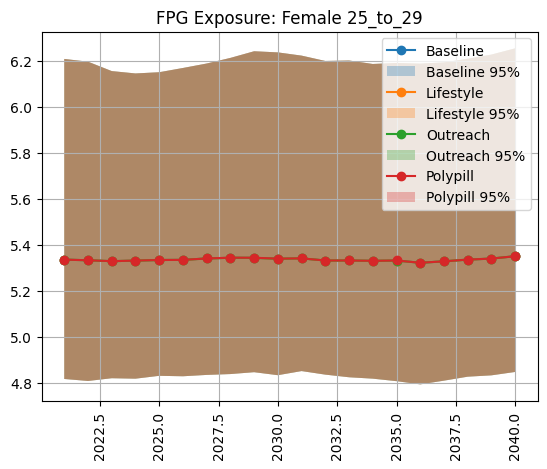

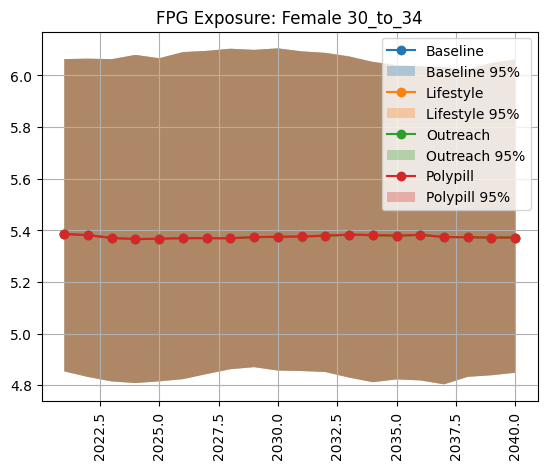

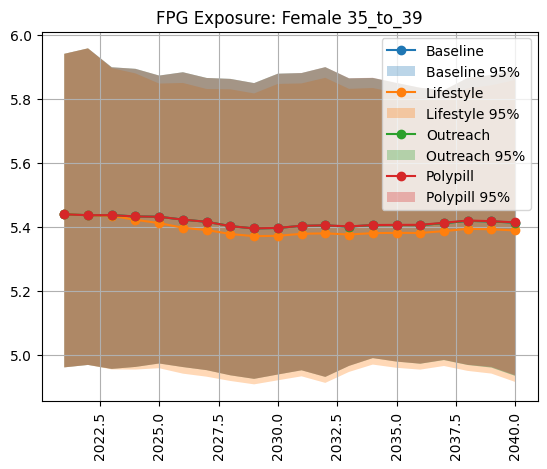

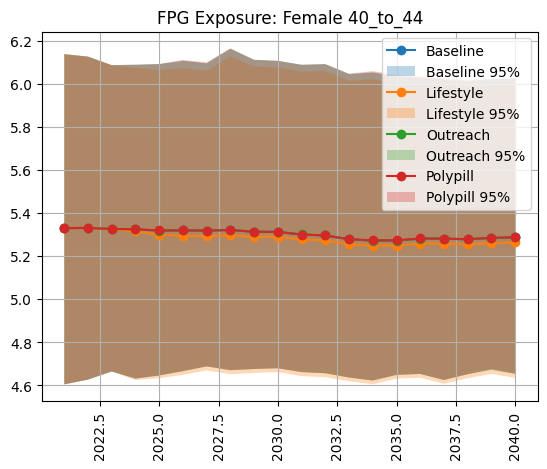

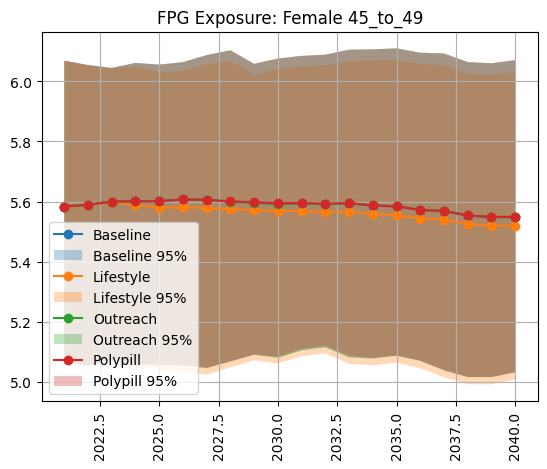

...

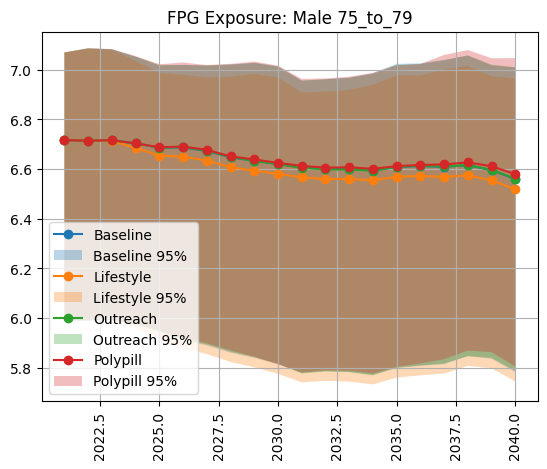

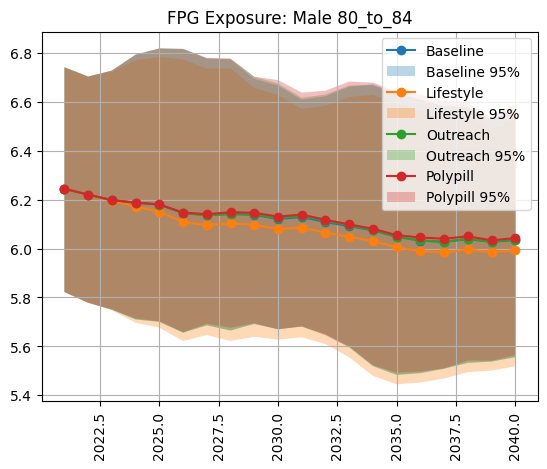

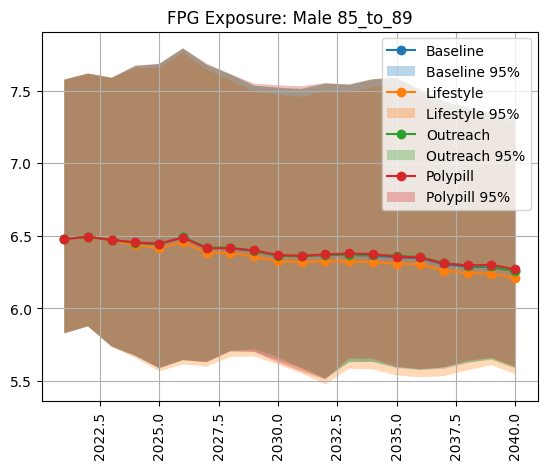

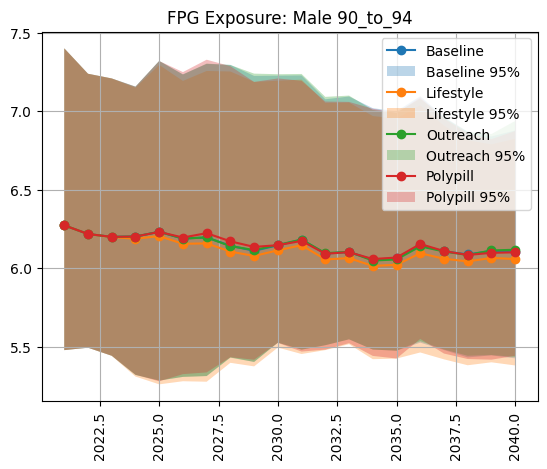

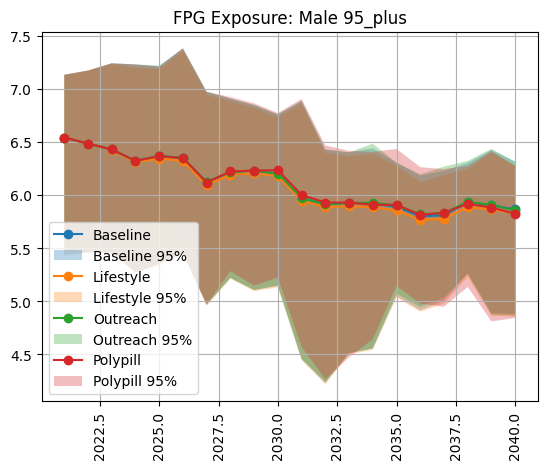

In [20]:
#%%capture
for sex in fpg_exp_rate_summ.sex.unique():
    for age in fpg_exp_rate_summ.age.unique():
        plt.figure() 
        subdata = fpg_exp_rate_summ.loc[(fpg_exp_rate_summ.sex==sex) & (fpg_exp_rate_summ.age==age) & (fpg_exp_rate_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = fpg_exp_rate_summ.loc[(fpg_exp_rate_summ.sex==sex) & (fpg_exp_rate_summ.age==age) & (fpg_exp_rate_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = fpg_exp_rate_summ.loc[(fpg_exp_rate_summ.sex==sex) & (fpg_exp_rate_summ.age==age) & (fpg_exp_rate_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata = fpg_exp_rate_summ.loc[(fpg_exp_rate_summ.sex==sex) & (fpg_exp_rate_summ.age==age) & (fpg_exp_rate_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.fill_between(subdata['year'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        plt.legend(['Baseline','Baseline 95%','Lifestyle','Lifestyle 95%','Outreach','Outreach 95%','Polypill','Polypill 95%'])
        plt.title(f'FPG Exposure: {sex} {age}') 
        plt.xticks(rotation=90) 
        #plt.ylim(0,100000)
        plt.grid()

Very modest improvments for lifestyle intervention. 

## Comparison to Artifacts

In [21]:
ls /mnt/team/simulation_science/costeffectiveness/artifacts/vivarium_nih_us_cvd/51-locations/v1-20230613

alabama.hdf               logs/               ohio.hdf
alaska.hdf                louisiana.hdf       oklahoma.hdf
arizona.hdf               maine.hdf           oregon.hdf
arkansas.hdf              maryland.hdf        paf-calculations/
california.hdf            massachusetts.hdf   pennsylvania.hdf
colorado.hdf              michigan.hdf        rhode_island.hdf
connecticut.hdf           minnesota.hdf       south_carolina.hdf
delaware.hdf              mississippi.hdf     south_dakota.hdf
district_of_columbia.hdf  missouri.hdf        south_dakotatennessee.hdf
florida.hdf               montana.hdf         tennessee.hdf
georgia.hdf               nebraska.hdf        texas.hdf
hawaii.hdf                nevada.hdf          utah.hdf
idaho.hdf                 new_hampshire.hdf   vermont.hdf
illinois.hdf              new_jersey.hdf      virginia.hdf
indiana.hdf               new_mexico.hdf      washington.hdf
iowa.hdf                  new_york.hdf        west_virginia.hdf
kansas.hdf                

In [22]:
from vivarium import Artifact

#explore the artifact data (note age groups)
art = Artifact('/mnt/team/simulation_science/costeffectiveness/artifacts/vivarium_nih_us_cvd/51-locations/alabama.hdf', filter_terms=['year_start == 2019', 'age_start >=  25'])

In [17]:
#art.keys

In [28]:
locations = ['alabama']

In [29]:
def load_artifact_data(word:str, cause:str, measure:str):
    master_art_data = pd.DataFrame()
    for i in locations: #in case there are other countries
        
        # grab main artifact object
        art = Artifact('/mnt/team/simulation_science/costeffectiveness/artifacts/vivarium_nih_us_cvd/51-locations/v1-20230613/' + i + '.hdf', 
                   filter_terms=['year_start == 2019', 'age_start >=  25']) # << MIGHT WANT TO CHANGE THESE TERMS
        
        # load requested measure
        data = art.load(word + '.' + cause + '.' + measure)
        #data = data[['draw_29','draw_232','draw_357','draw_394','draw_602','draw_629','draw_650','draw_680','draw_829','draw_949']]

        # collapse to desired percentiles
        data = data.apply(pd.DataFrame.describe, percentiles=[0.025, 0.5, 0.975], axis=1).filter(['mean', '50%', '2.5%', '97.5%']).reset_index()
        
        # formatting (may want to format age as well)
        data['location'] = i#.capitalize()
        data['measure'] = measure
        #data['sex'] = np.where(data['sex'] == 'Female', 'female', 'male')
    
   
        master_art_data = master_art_data.append(data)
        
    return master_art_data

### BMI

In [30]:
bmi_art = load_artifact_data('risk_factor', 'high_body_mass_index_in_adults', 'exposure')
bmi_art['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(bmi_art.age_start,bmi_art.age_end)]
bmi_art.head()

,sex,age_start,age_end,year_start,year_end,parameter,mean,50%,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,continuous,30.899912,30.892990,30.572156,31.233780,alabama,exposure,25_to_29
1,Female,30.0,35.0,2019,2020,continuous,31.636913,31.638236,31.293987,31.989474,alabama,exposure,30_to_34
2,Female,35.0,40.0,2019,2020,continuous,31.883495,31.884883,31.555235,32.210906,alabama,exposure,35_to_39
3,Female,40.0,45.0,2019,2020,continuous,32.130649,32.123262,31.801051,32.462829,alabama,exposure,40_to_44
4,Female,45.0,50.0,2019,2020,continuous,32.169931,32.165649,31.855765,32.505542,alabama,exposure,45_to_49


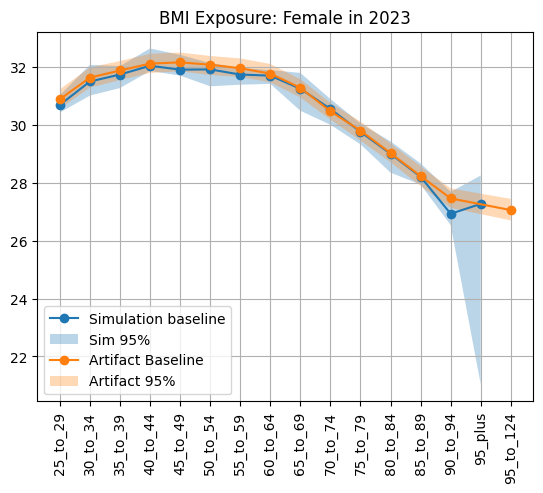

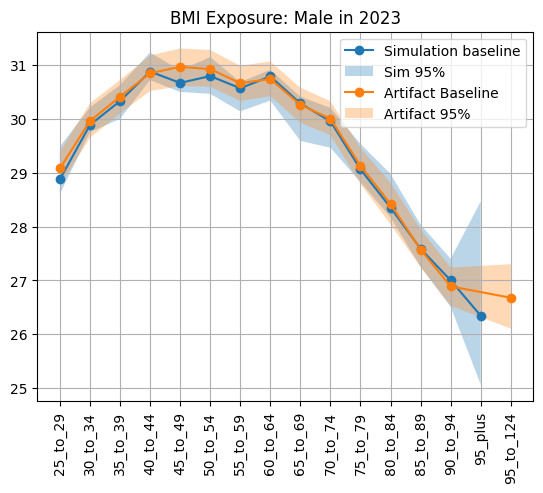

In [32]:
for sex in bmi_exp_rate_summ.sex.unique():
    plt.figure() 
    subdata = bmi_exp_rate_summ.loc[(bmi_exp_rate_summ.sex==sex) & (bmi_exp_rate_summ.year==2023) & (bmi_exp_rate_summ.scenario == 'baseline')]
    plt.plot(subdata['age'], subdata['50%'], marker='o')
    plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
    subdata2 = bmi_art.loc[(bmi_art.sex==sex) & (bmi_art.year_end==2020)]
    plt.plot(subdata2['age_group'], subdata2['50%'], marker='o')
    plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
    plt.title(f'BMI Exposure: {sex} in 2023') 
    plt.xticks(rotation=90) 
    #plt.ylim(0,100000)
    plt.grid()
    plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

### SBP

In [33]:
sbp_art = load_artifact_data('risk_factor', 'high_systolic_blood_pressure', 'exposure')
sbp_art['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(sbp_art.age_start,sbp_art.age_end)]
sbp_art.head()

,sex,age_start,age_end,year_start,year_end,parameter,mean,50%,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,continuous,110.635893,110.623634,107.945700,113.550750,alabama,exposure,25_to_29
1,Female,30.0,35.0,2019,2020,continuous,112.876275,112.881309,110.098198,115.523727,alabama,exposure,30_to_34
2,Female,35.0,40.0,2019,2020,continuous,116.139886,116.134678,113.594023,118.770064,alabama,exposure,35_to_39
3,Female,40.0,45.0,2019,2020,continuous,118.491616,118.514616,115.903577,121.039457,alabama,exposure,40_to_44
4,Female,45.0,50.0,2019,2020,continuous,121.645391,121.618436,118.875235,124.529834,alabama,exposure,45_to_49


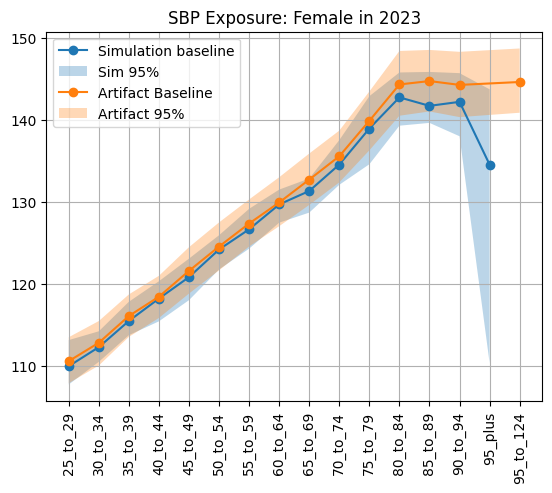

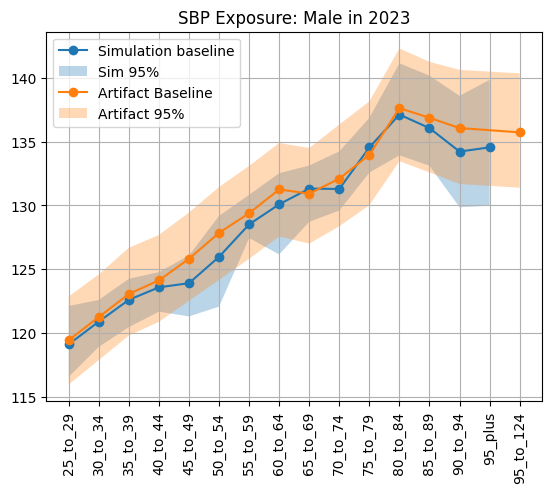

In [34]:
for sex in sbp_exp_rate_summ.sex.unique():
    plt.figure() 
    subdata = sbp_exp_rate_summ.loc[(sbp_exp_rate_summ.sex==sex) & (sbp_exp_rate_summ.year==2023) & (sbp_exp_rate_summ.scenario == 'baseline')]
    plt.plot(subdata['age'], subdata['mean'], marker='o')
    plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
    subdata2 = sbp_art.loc[(sbp_art.sex==sex) & (sbp_art.year_end==2020)]
    plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
    plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
    plt.title(f'SBP Exposure: {sex} in 2023')
    plt.xticks(rotation=90) 
    #plt.ylim(0,100000)
    plt.grid()
    plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

### LDL-C

In [35]:
ldl_art = load_artifact_data('risk_factor', 'high_ldl_cholesterol', 'exposure')
ldl_art['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(ldl_art.age_start,ldl_art.age_end)]
ldl_art.head()

,sex,age_start,age_end,year_start,year_end,parameter,mean,50%,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,continuous,2.639862,2.638003,2.472574,2.821188,alabama,exposure,25_to_29
1,Female,30.0,35.0,2019,2020,continuous,2.724353,2.723671,2.553736,2.905134,alabama,exposure,30_to_34
2,Female,35.0,40.0,2019,2020,continuous,2.802925,2.801341,2.639513,2.972487,alabama,exposure,35_to_39
3,Female,40.0,45.0,2019,2020,continuous,2.880791,2.878250,2.721814,3.039119,alabama,exposure,40_to_44
4,Female,45.0,50.0,2019,2020,continuous,2.998297,2.995129,2.837974,3.175367,alabama,exposure,45_to_49


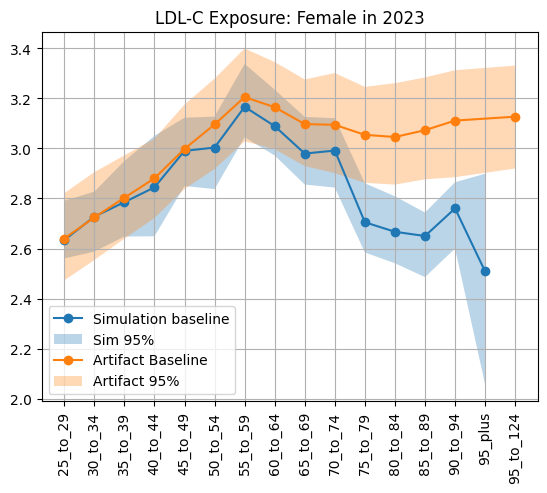

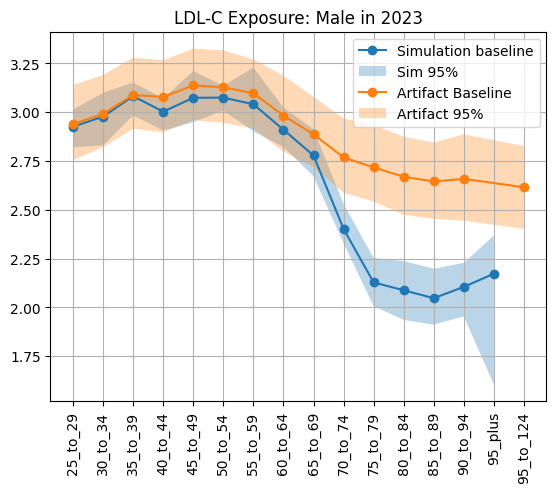

In [37]:
for sex in ldl_exp_rate_summ.sex.unique():
    plt.figure() 
    subdata = ldl_exp_rate_summ.loc[(ldl_exp_rate_summ.sex==sex) & (ldl_exp_rate_summ.year==2040) & (ldl_exp_rate_summ.scenario == 'baseline')]
    plt.plot(subdata['age'], subdata['mean'], marker='o')
    plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
    subdata2 = ldl_art.loc[(ldl_art.sex==sex) & (ldl_art.year_end==2020)]
    plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
    plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
    plt.title(f'LDL-C Exposure: {sex} in 2023') 
    plt.xticks(rotation=90) 
    #plt.ylim(0,100000)
    plt.grid()
    plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

### FPG

In [38]:
fpg_art = load_artifact_data('risk_factor', 'high_fasting_plasma_glucose', 'exposure')
fpg_art['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(fpg_art.age_start,fpg_art.age_end)]
fpg_art.head()

,sex,age_start,age_end,year_start,year_end,parameter,mean,50%,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,continuous,5.316303,5.307507,4.613215,6.137399,alabama,exposure,25_to_29
1,Female,30.0,35.0,2019,2020,continuous,5.461718,5.447329,4.696085,6.297658,alabama,exposure,30_to_34
2,Female,35.0,40.0,2019,2020,continuous,5.538952,5.538472,4.750516,6.371252,alabama,exposure,35_to_39
3,Female,40.0,45.0,2019,2020,continuous,5.659873,5.650779,4.873814,6.494619,alabama,exposure,40_to_44
4,Female,45.0,50.0,2019,2020,continuous,5.787248,5.771666,5.004493,6.682187,alabama,exposure,45_to_49


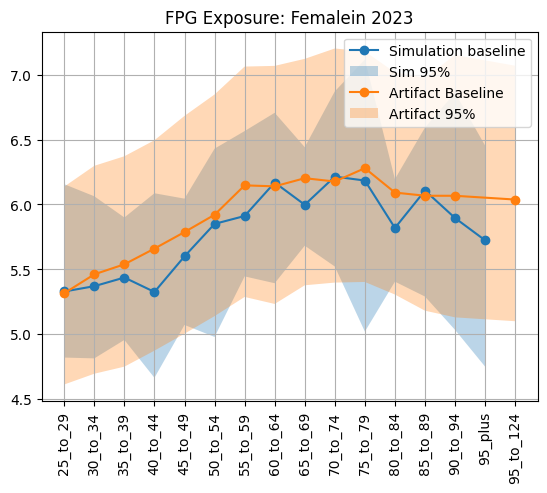

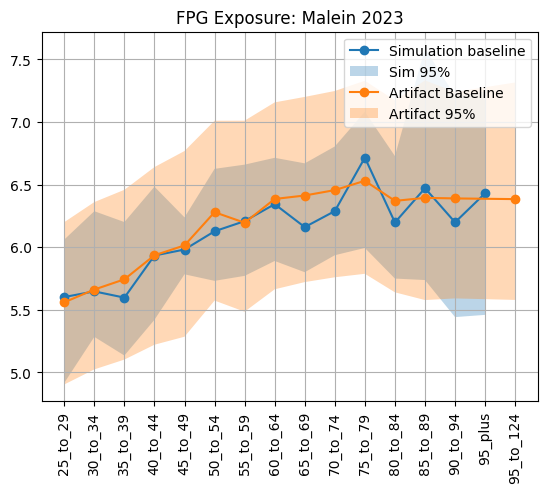

In [39]:
for sex in fpg_exp_rate_summ.sex.unique():
    plt.figure() 
    subdata = fpg_exp_rate_summ.loc[(fpg_exp_rate_summ.sex==sex) & (fpg_exp_rate_summ.year==2023) & (fpg_exp_rate_summ.scenario == 'baseline')]
    plt.plot(subdata['age'], subdata['mean'], marker='o')
    plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
    subdata2 = fpg_art.loc[(fpg_art.sex==sex) & (fpg_art.year_end==2020)]
    plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
    plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
    plt.title(f'FPG Exposure: {sex} in 2023')
    plt.xticks(rotation=90) 
    #plt.ylim(0,100000)
    plt.grid()
    plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

Very interestingly (and almost worse overall) FPG is working great while the other 3 are looking bad

# SBP Medications

In [13]:
meds = pd.read_csv(sim_results_dir + '/sbp_medication_person_time.csv')
meds.head()

,Unnamed: 0,sex,year,measure,input_draw,scenario,age,medication_adherence,sbp_medication,value
0,0,Female,2021,sbp_medication_person_time,29,baseline,25_to_29,primary_non_adherent,no_treatment,284.561259
1,1,Female,2021,sbp_medication_person_time,29,lifestyle_100,25_to_29,primary_non_adherent,no_treatment,284.561259
2,2,Female,2021,sbp_medication_person_time,29,outreach_100,25_to_29,primary_non_adherent,no_treatment,284.561259
3,3,Female,2021,sbp_medication_person_time,29,polypill_100,25_to_29,primary_non_adherent,no_treatment,284.561259
4,4,Female,2021,sbp_medication_person_time,29,baseline,25_to_29,secondary_non_adherent,no_treatment,183.600274


In [14]:
meds_adherent = meds#.loc[meds['medication_adherence']=='adherent'].reset_index()
meds_adherent = meds_adherent.groupby(['input_draw','sex','age', 'year', 'sbp_medication','scenario']).value.sum().reset_index()
meds_adherent_rate = meds_adherent.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario']], on=['sex','age','year','input_draw','scenario'])
meds_adherent_rate['meds_adherent_rate'] = meds_adherent_rate['value'] / meds_adherent_rate['ptvalue']
meds_adherent_rate_summ = (meds_adherent_rate
                .groupby(['sex', 'age','year', 'sbp_medication','scenario'])
                .meds_adherent_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
meds_adherent_rate_summ

,sex,age,year,sbp_medication,scenario,mean,2.5%,97.5%
0,Female,25_to_29,2021,no_treatment,baseline,0.900643,0.884139,0.917327
1,Female,25_to_29,2021,no_treatment,lifestyle_100,0.900643,0.884139,0.917327
2,Female,25_to_29,2021,no_treatment,outreach_100,0.900643,0.884139,0.917327
3,Female,25_to_29,2021,no_treatment,polypill_100,0.900643,0.884139,0.917327
...,...,...,...,...,...,...,...,...
16796,Male,95_plus,2040,two_drug_std_dose_efficacy,baseline,0.022387,0.000000,0.040897
16797,Male,95_plus,2040,two_drug_std_dose_efficacy,lifestyle_100,0.021791,0.000000,0.039521
16798,Male,95_plus,2040,two_drug_std_dose_efficacy,outreach_100,0.022214,0.000000,0.040720
16799,Male,95_plus,2040,two_drug_std_dose_efficacy,polypill_100,0.000000,0.000000,0.000000


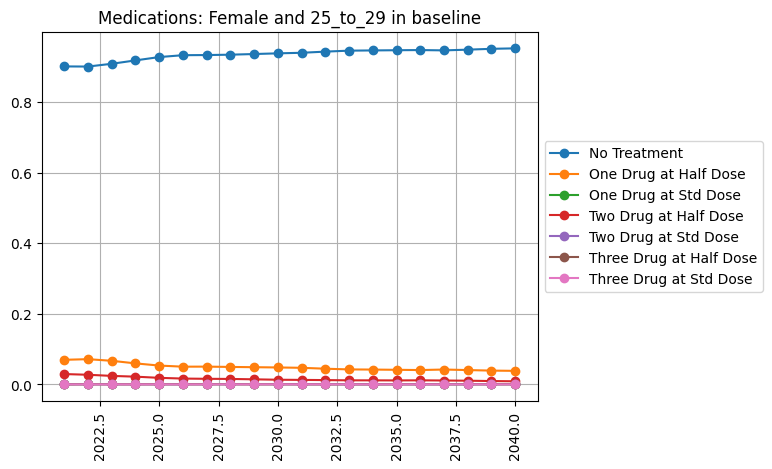

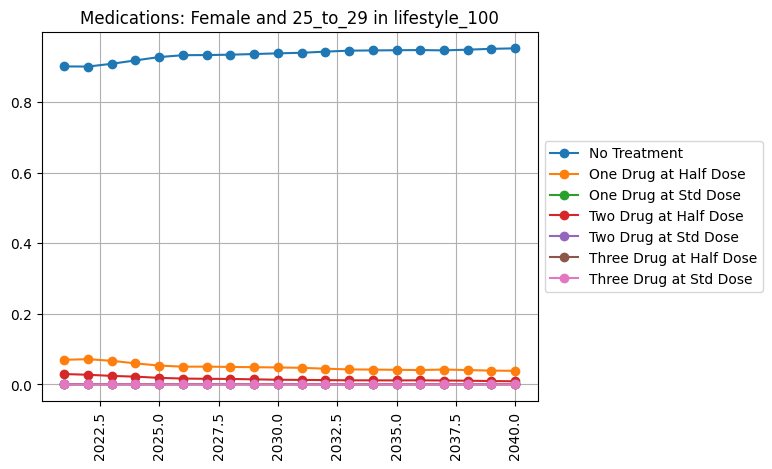

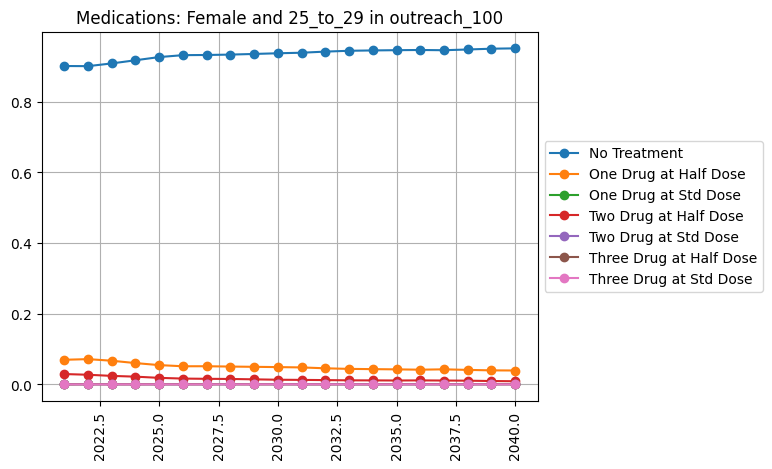

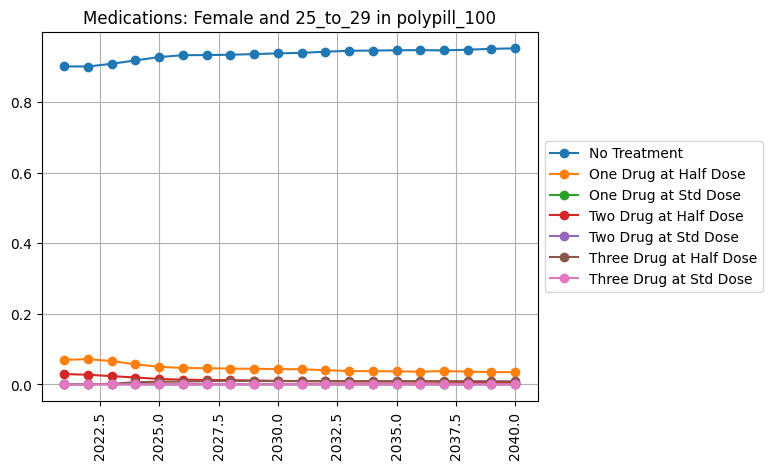

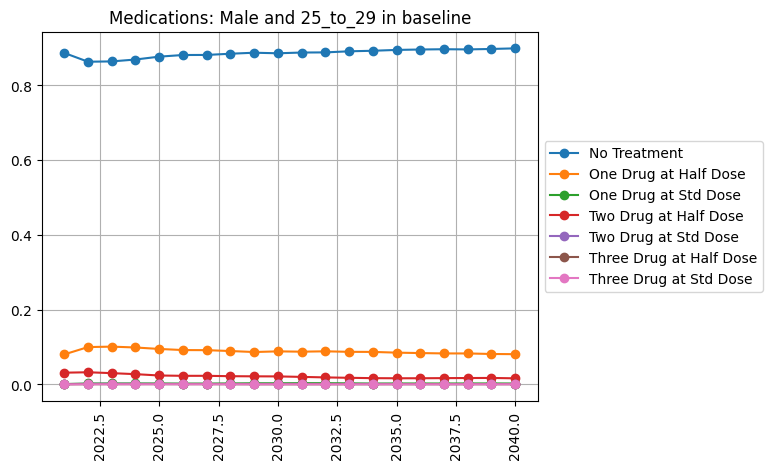

...

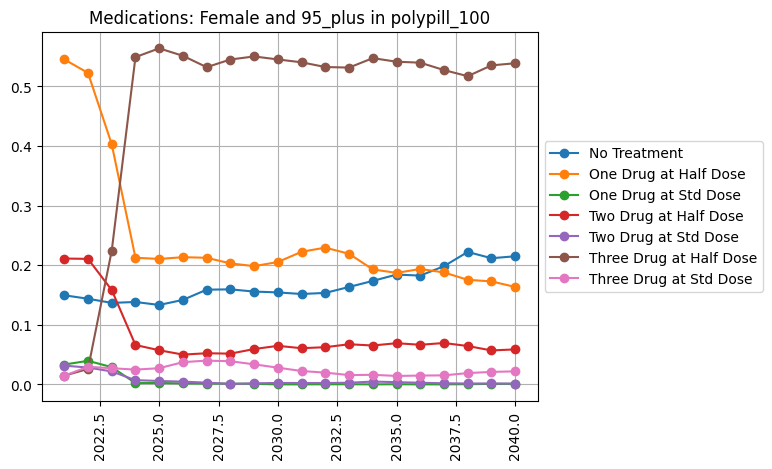

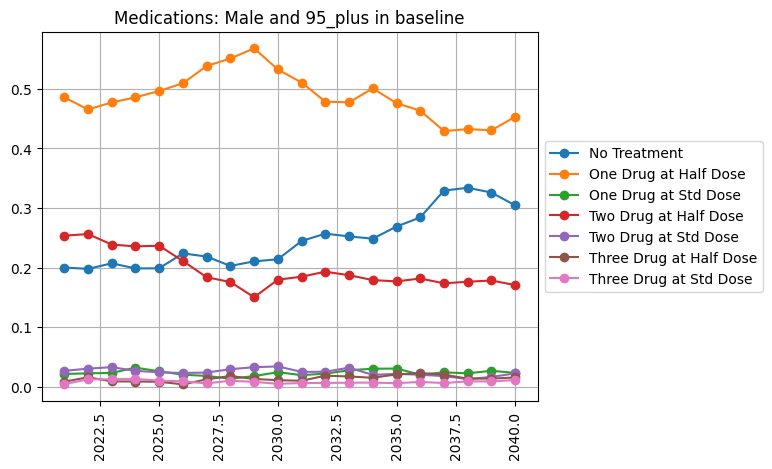

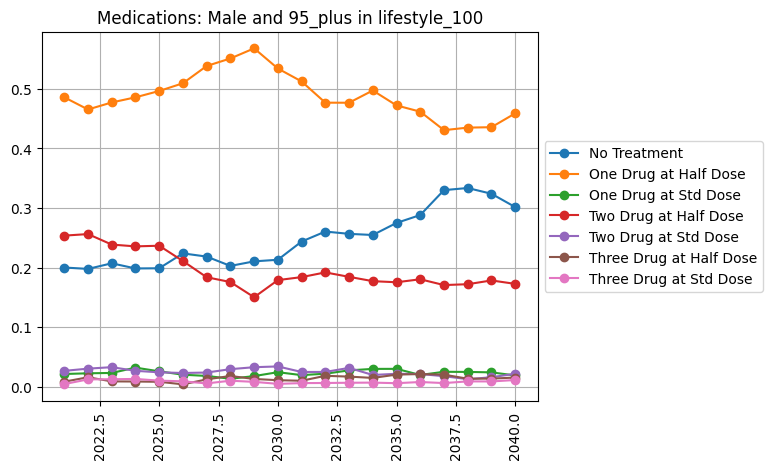

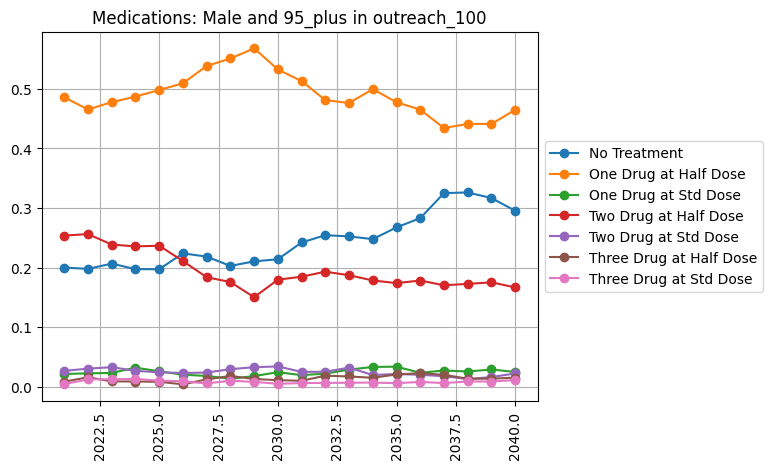

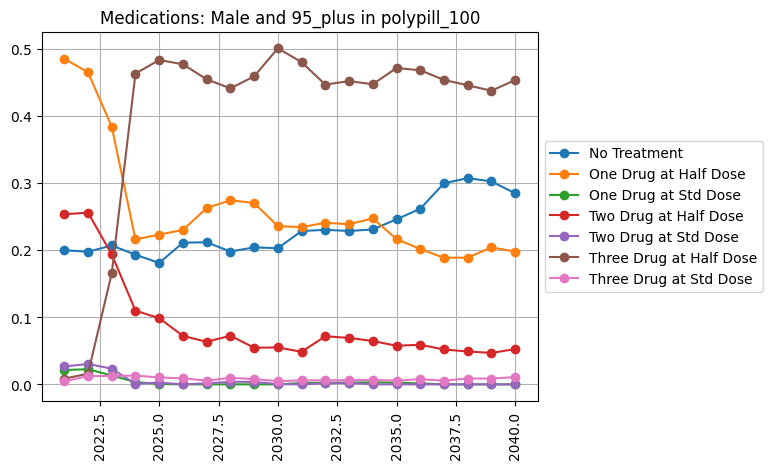

In [15]:
#%%capture
with PdfPages('sbp_meds_081423.pdf') as pdf:
    for age in meds_adherent_rate_summ.age.unique():
        for sex in meds_adherent_rate_summ.sex.unique():
            for scenario in meds_adherent_rate_summ.scenario.unique(): 
                plt.figure() 
                no_trt = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='no_treatment')]
                plt.plot(no_trt['year'], no_trt['mean'], marker='o')
                #plt.fill_between(no_trt['year'], no_trt['2.5%'], no_trt['97.5%'], alpha=.3)
                one_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='one_drug_half_dose_efficacy')]
                plt.plot(one_half['year'], one_half['mean'], marker='o')
                #plt.fill_between(one_half['year'], one_half['2.5%'], one_half['97.5%'], alpha=.3)
                one_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='one_drug_std_dose_efficacy')]
                plt.plot(one_std['year'], one_std['mean'], marker='o')
                #plt.fill_between(one_std['year'], one_std['2.5%'], one_std['97.5%'], alpha=.3)
                two_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='two_drug_half_dose_efficacy')]
                plt.plot(two_half['year'], two_half['mean'], marker='o')
                #plt.fill_between(two_half['year'], two_half['2.5%'], two_half['97.5%'], alpha=.3)
                two_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='two_drug_std_dose_efficacy')]
                plt.plot(two_std['year'], two_std['mean'], marker='o')
                #plt.fill_between(two_std['year'], two_std['2.5%'], two_std['97.5%'], alpha=.3)
                three_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='three_drug_half_dose_efficacy')]
                plt.plot(three_half['year'], three_half['mean'], marker='o')
                #plt.fill_between(three_half['year'], three_half['2.5%'], three_half['97.5%'], alpha=.3)
                three_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.sbp_medication=='three_drug_std_dose_efficacy')]
                plt.plot(three_std['year'], three_std['mean'], marker='o')
                #plt.fill_between(three_std['year'], three_std['2.5%'], three_std['97.5%'], alpha=.3)
                plt.title(f'Medications: {sex} and {age} in {scenario}') 
                plt.xticks(rotation=90)
                plt.legend(['No Treatment', 'One Drug at Half Dose','One Drug at Std Dose','Two Drug at Half Dose','Two Drug at Std Dose','Three Drug at Half Dose','Three Drug at Std Dose'],loc='center left', bbox_to_anchor=(1, 0.5))
                plt.grid()
                pdf.savefig(bbox_inches='tight')

In [16]:
ldl_meds = pd.read_csv(sim_results_dir + '/ldlc_medication_person_time.csv')
ldl_meds.head()

,Unnamed: 0,sex,year,measure,input_draw,scenario,age,medication_adherence,ldlc_medication,value
0,0,Female,2021,ldlc_medication_person_time,29,baseline,25_to_29,primary_non_adherent,high_intensity,0.0
1,1,Female,2021,ldlc_medication_person_time,29,lifestyle_100,25_to_29,primary_non_adherent,high_intensity,0.0
2,2,Female,2021,ldlc_medication_person_time,29,outreach_100,25_to_29,primary_non_adherent,high_intensity,0.0
3,3,Female,2021,ldlc_medication_person_time,29,polypill_100,25_to_29,primary_non_adherent,high_intensity,0.0
4,4,Female,2021,ldlc_medication_person_time,29,baseline,25_to_29,secondary_non_adherent,high_intensity,0.0


In [17]:
meds_adherent = ldl_meds#.loc[ldl_meds['medication_adherence']=='adherent'].reset_index()
meds_adherent = meds_adherent.groupby(['input_draw','sex','age', 'year', 'ldlc_medication','scenario']).value.sum().reset_index()
meds_adherent_rate = meds_adherent.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario']], on=['sex','age','year','input_draw','scenario'])
meds_adherent_rate['meds_adherent_rate'] = meds_adherent_rate['value'] / meds_adherent_rate['ptvalue']
meds_adherent_rate_summ = (meds_adherent_rate
                .groupby(['sex','age', 'year', 'ldlc_medication','scenario'])
                .meds_adherent_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
meds_adherent_rate_summ

,sex,age,year,ldlc_medication,scenario,mean,2.5%,97.5%
0,Female,25_to_29,2021,high_intensity,baseline,0.007830,0.005562,0.010059
1,Female,25_to_29,2021,high_intensity,lifestyle_100,0.007830,0.005562,0.010059
2,Female,25_to_29,2021,high_intensity,outreach_100,0.007830,0.005562,0.010059
3,Female,25_to_29,2021,high_intensity,polypill_100,0.007830,0.005562,0.010059
...,...,...,...,...,...,...,...,...
14396,Male,95_plus,2040,no_treatment,baseline,0.454556,0.288384,0.594003
14397,Male,95_plus,2040,no_treatment,lifestyle_100,0.449867,0.282780,0.593684
14398,Male,95_plus,2040,no_treatment,outreach_100,0.451582,0.280640,0.594202
14399,Male,95_plus,2040,no_treatment,polypill_100,0.461077,0.318150,0.612066


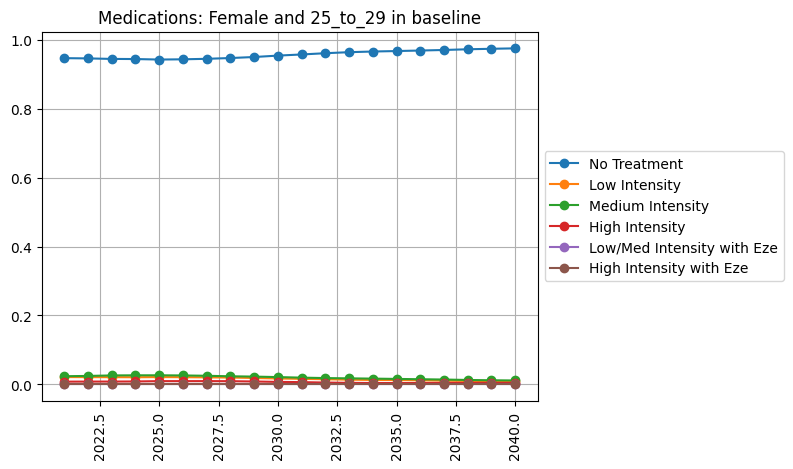

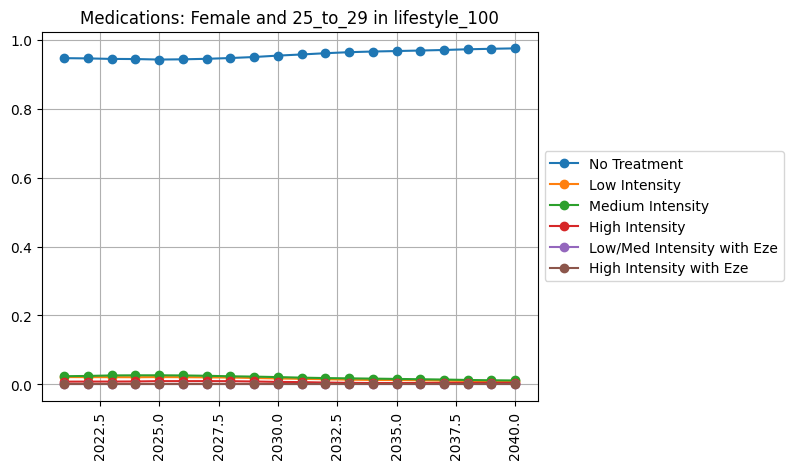

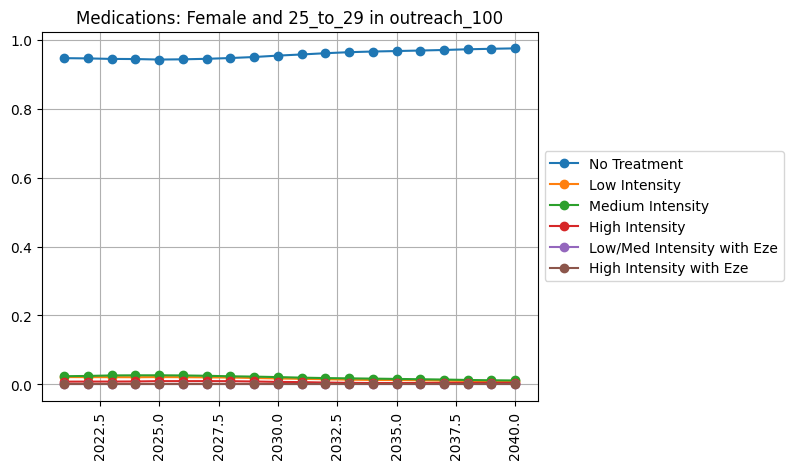

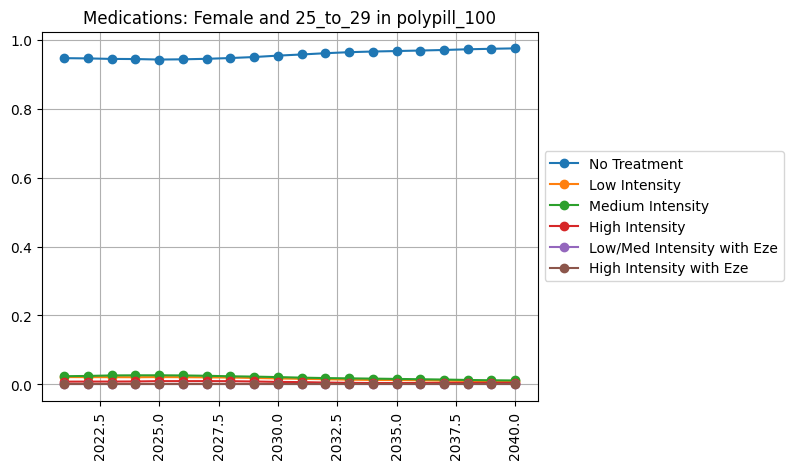

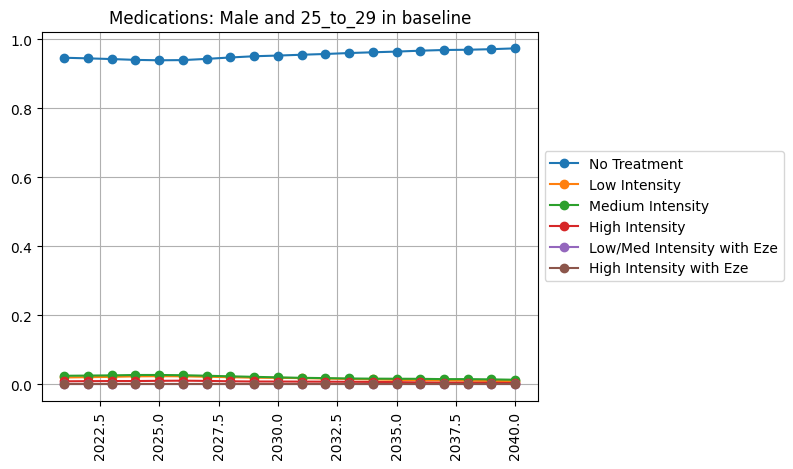

...

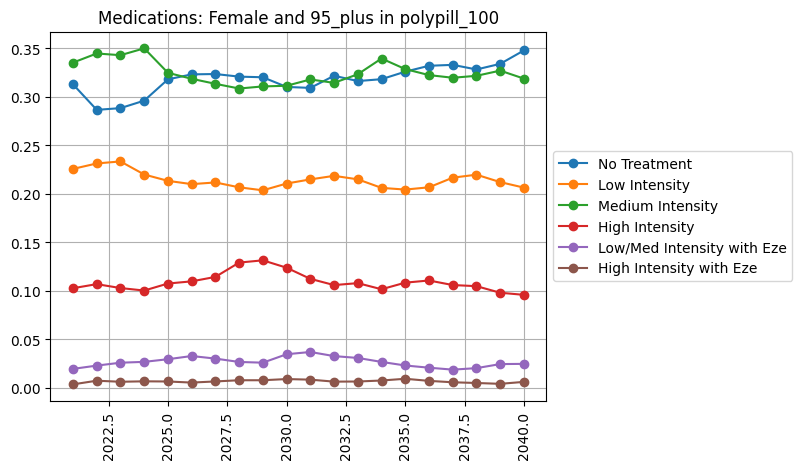

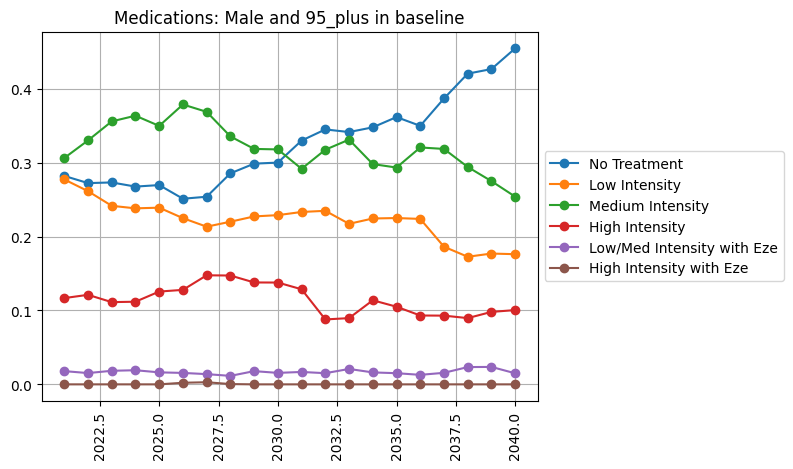

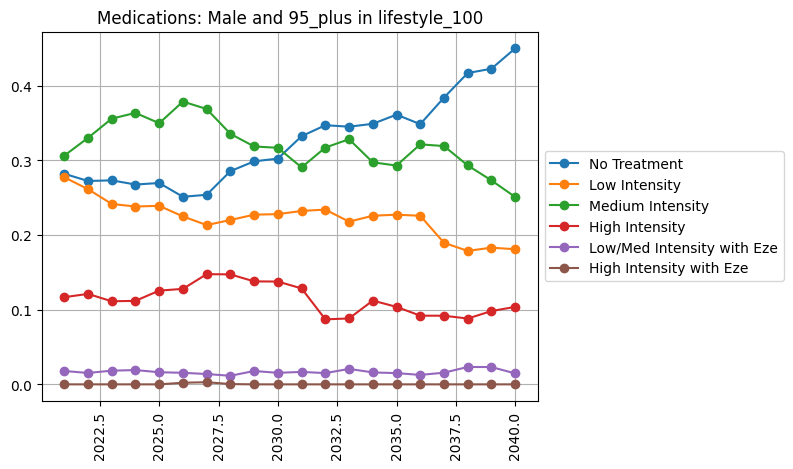

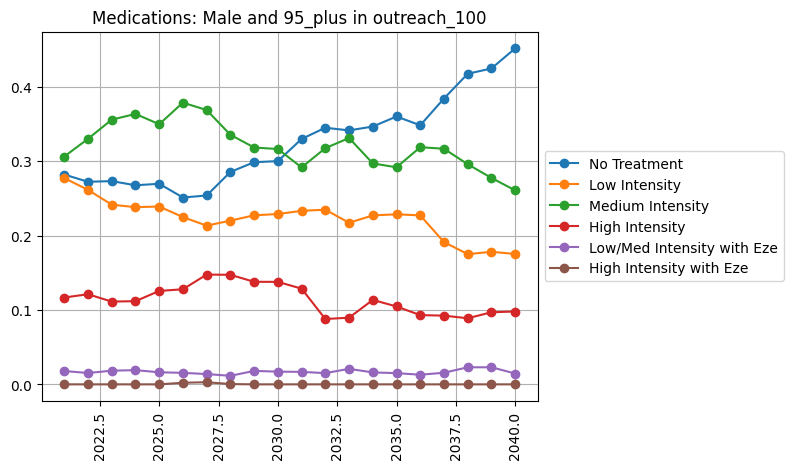

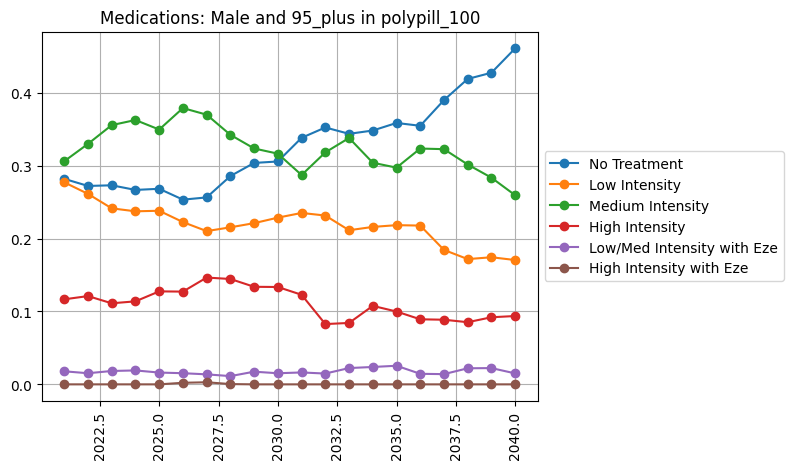

In [18]:
#%%capture
with PdfPages('ldlc_meds_081423.pdf') as pdf:
    for age in meds_adherent_rate_summ.age.unique():
        for sex in meds_adherent_rate_summ.sex.unique():
            for scenario in meds_adherent_rate_summ.scenario.unique():
                plt.figure() 
                no_trt = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.ldlc_medication=='no_treatment')]
                plt.plot(no_trt['year'], no_trt['mean'], marker='o')
                #plt.fill_between(no_trt['year'], no_trt['2.5%'], no_trt['97.5%'], alpha=.3)
                one_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.ldlc_medication=='low_intensity')]
                plt.plot(one_half['year'], one_half['mean'], marker='o')
                #plt.fill_between(one_half['year'], one_half['2.5%'], one_half['97.5%'], alpha=.3)
                one_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.ldlc_medication=='medium_intensity')]
                plt.plot(one_std['year'], one_std['mean'], marker='o')
                #plt.fill_between(one_std['year'], one_std['2.5%'], one_std['97.5%'], alpha=.3)
                two_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.ldlc_medication=='high_intensity')]
                plt.plot(two_half['year'], two_half['mean'], marker='o')
                #plt.fill_between(two_half['year'], two_half['2.5%'], two_half['97.5%'], alpha=.3)
                two_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.ldlc_medication=='low_med_with_eze')]
                plt.plot(two_std['year'], two_std['mean'], marker='o')
                #plt.fill_between(two_std['year'], two_std['2.5%'], two_std['97.5%'], alpha=.3)
                three_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.scenario==scenario) & (meds_adherent_rate_summ.ldlc_medication=='high_with_eze')]
                plt.plot(three_half['year'], three_half['mean'], marker='o')
                #plt.fill_between(three_half['year'], three_half['2.5%'], three_half['97.5%'], alpha=.3)
                plt.title(f'Medications: {sex} and {age} in {scenario}') 
                plt.xticks(rotation=90)
                plt.legend(['No Treatment','Low Intensity','Medium Intensity','High Intensity','Low/Med Intensity with Eze','High Intensity with Eze'],loc='center left', bbox_to_anchor=(1, 0.5))
                plt.grid()
                pdf.savefig(bbox_inches='tight')

The outreach looks funny - the no treatment group increases? Need to investigate further 

## Time in Interventions 

In [42]:
intervention = pd.read_csv(sim_results_dir + '/intervention_person_time.csv')
print(intervention.intervention_type.unique())
print(intervention.scenario.unique())

['outreach' 'polypill']
['baseline' 'lifestyle_100' 'lifestyle_50' 'outreach_100' 'outreach_50'
 'polypill_100' 'polypill_50']


In [43]:
outreach = intervention.loc[(intervention.intervention == 'yes') & (intervention.intervention_type == 'outreach')]
outreach = (outreach
                .groupby(['age', 'sex', 'year','scenario','location'])
                .value.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())

outreach.head()

,age,sex,year,scenario,mean,2.5%,97.5%
0,25_to_29,female,2023,baseline,0.000000,0.000000,0.000000
1,25_to_29,female,2023,lifestyle_100,0.000000,0.000000,0.000000
2,25_to_29,female,2023,lifestyle_50,0.000000,0.000000,0.000000
3,25_to_29,female,2023,outreach_100,1143.680219,974.033949,1335.783984
4,25_to_29,female,2023,outreach_50,572.395893,485.243258,667.567146


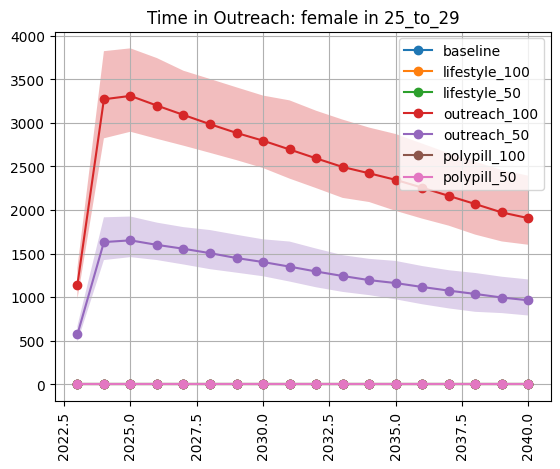

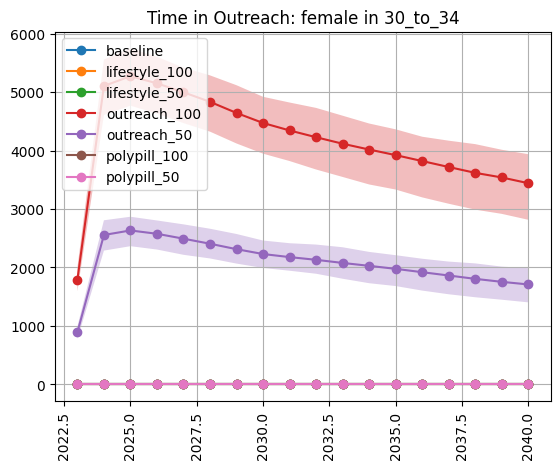

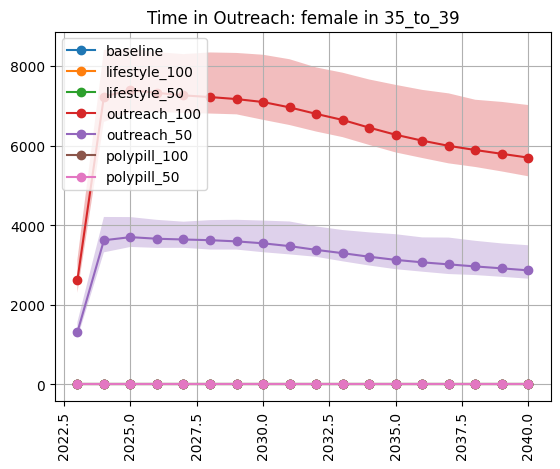

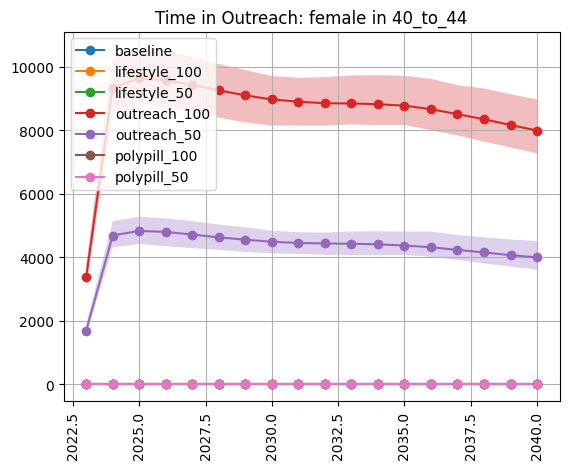

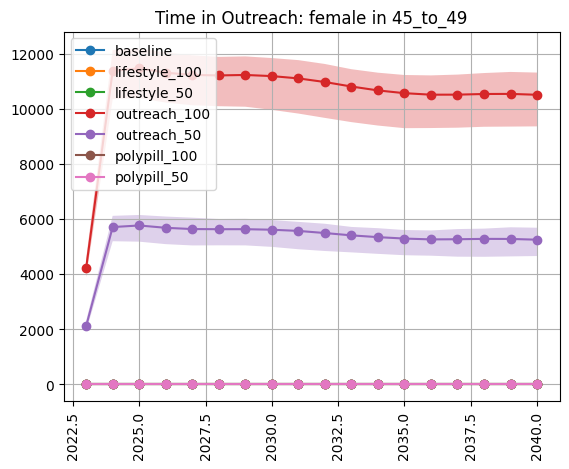

...

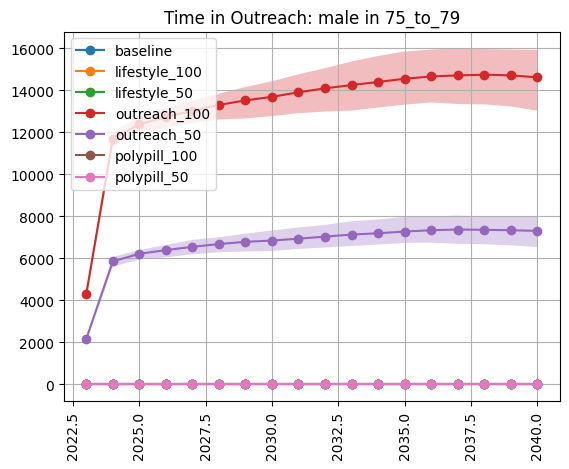

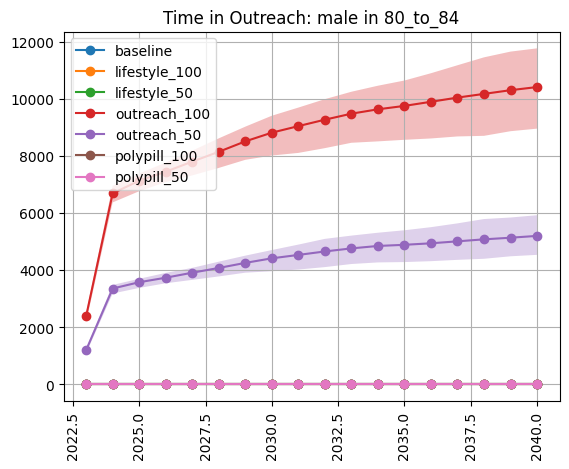

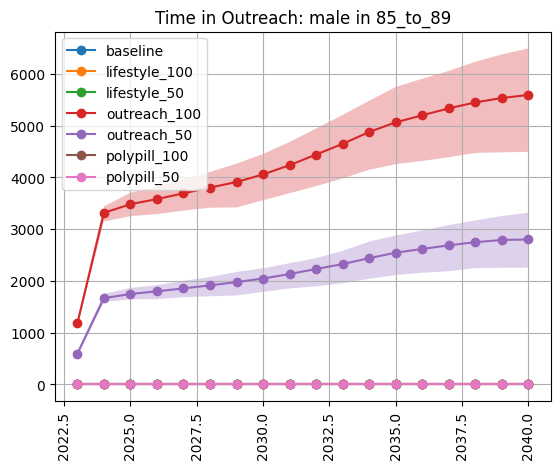

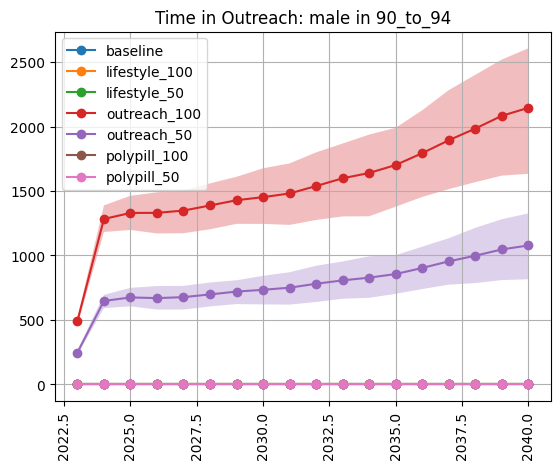

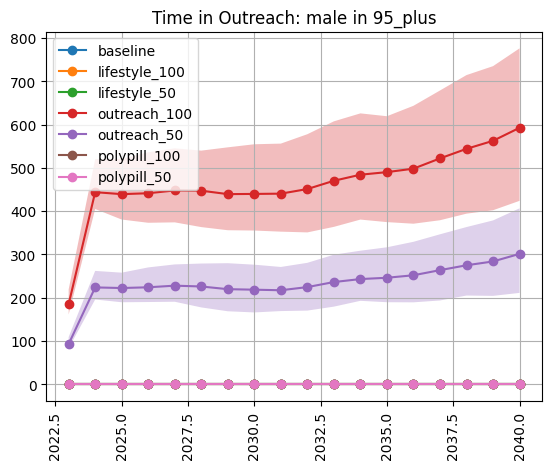

In [44]:
for location in outreach.location.unique():
    for sex in outreach.sex.unique():
        for age in outreach.age.unique():
            plt.figure() 
            subdata = outreach.loc[(outreach.location==location) & (outreach.sex==sex) & (outreach.age==age)]
            groups = subdata.groupby('scenario')
            for name, group in groups: 
                plt.plot(group['year'], group['mean'], marker='o', label=name)
                plt.fill_between(group['year'], group['2.5%'], group['97.5%'], alpha=.3)
            plt.legend()
            plt.title(f'Time in Outreach: {sex} and {location} in {age}') 
            plt.xticks(rotation=90) 
            plt.grid()

In [45]:
polypill = intervention.loc[(intervention.intervention == 'yes') & (intervention.intervention_type == 'polypill')]
polypill = (polypill
                .groupby(['age', 'sex', 'year','scenario','location'])
                .value.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())

polypill.head()

,age,sex,year,scenario,mean,2.5%,97.5%
0,25_to_29,female,2023,baseline,0.0,0.0,0.0
1,25_to_29,female,2023,lifestyle_100,0.0,0.0,0.0
2,25_to_29,female,2023,lifestyle_50,0.0,0.0,0.0
3,25_to_29,female,2023,outreach_100,0.0,0.0,0.0
4,25_to_29,female,2023,outreach_50,0.0,0.0,0.0


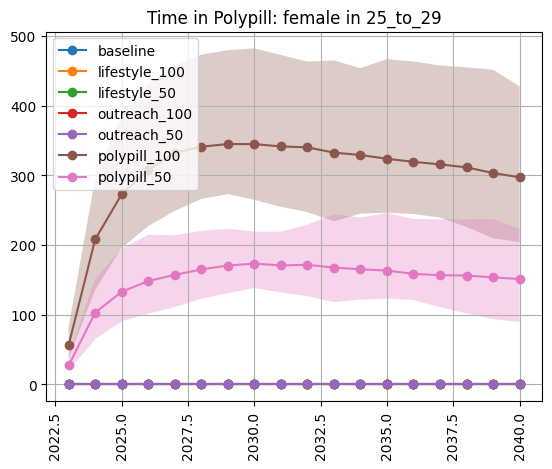

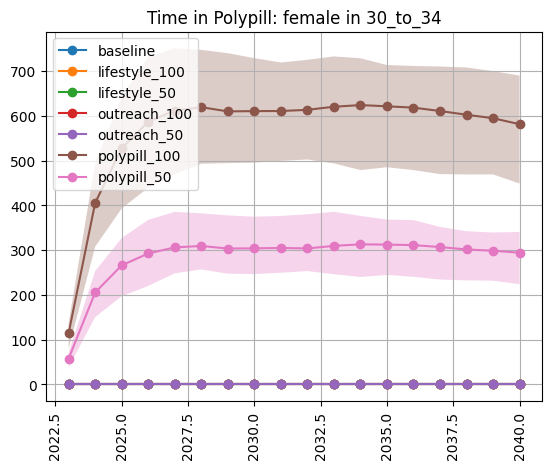

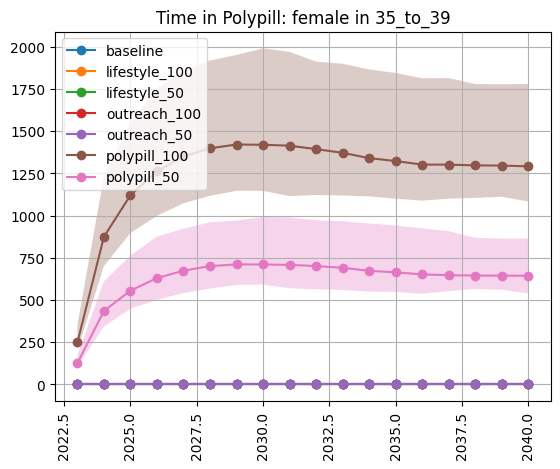

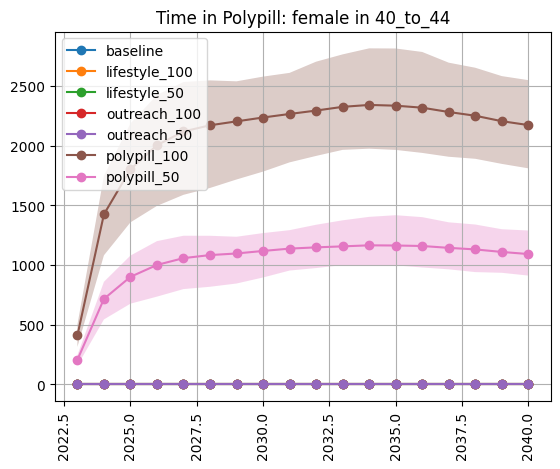

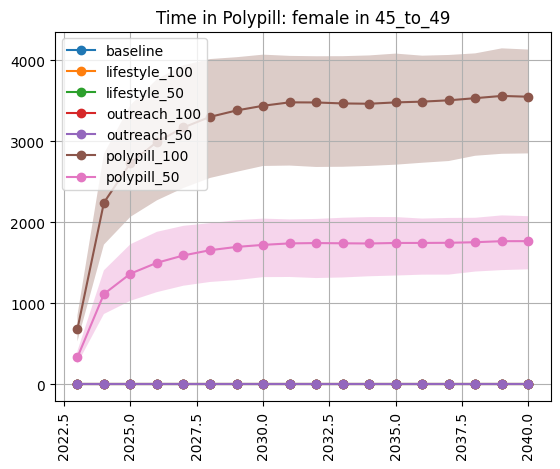

...

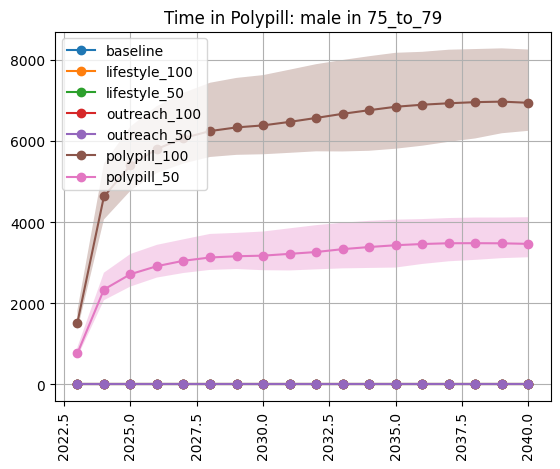

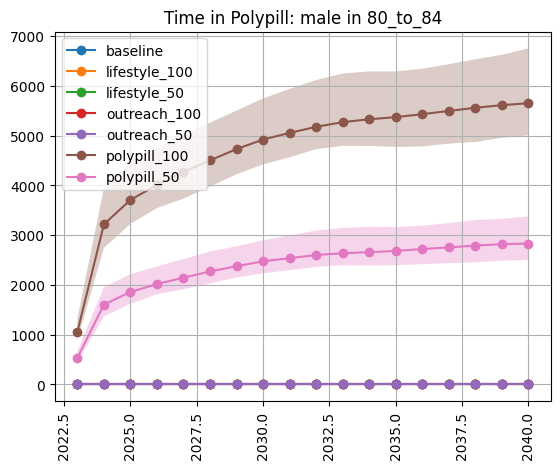

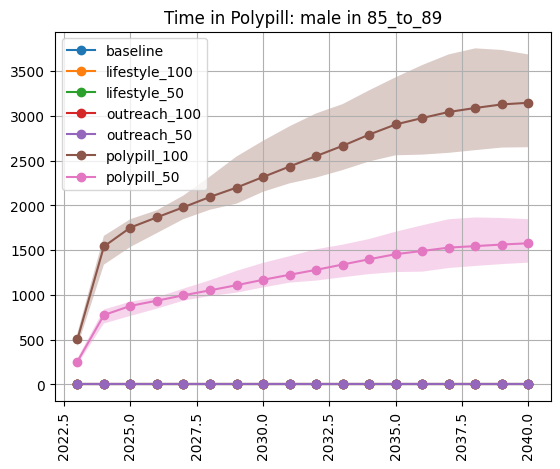

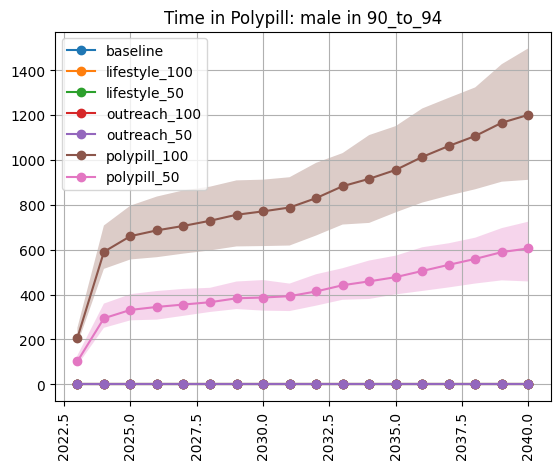

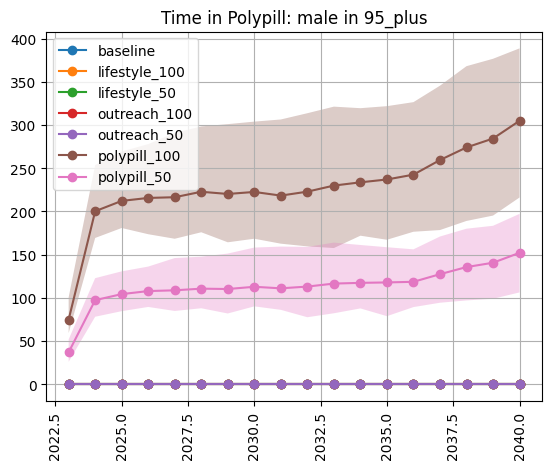

In [46]:
for location in polypill.location.unique():
    for sex in polypill.sex.unique():
        for age in polypill.age.unique():
            plt.figure() 
            subdata = polypill.loc[(polypill.location==location) & (polypill.sex==sex) & (polypill.age==age)]
            groups = subdata.groupby('scenario')
            for name, group in groups: 
                plt.plot(group['year'], group['mean'], marker='o', label=name)
                plt.fill_between(group['year'], group['2.5%'], group['97.5%'], alpha=.3)
            plt.legend()
            plt.title(f'Time in Polypill: {sex} and {location} in {age}') 
            plt.xticks(rotation=90) 
            plt.grid()
            pdf.savefig(bbox_inches='tight')

In [47]:
intervention.intervention_type.unique()

array(['outreach', 'polypill'], dtype=object)

In [48]:
lifestyle = intervention.loc[(intervention.intervention == 'yes') & (intervention.intervention_type == 'lifestyle')]
lifestyle = (lifestyle
                .groupby(['age', 'sex', 'year','scenario'])
                .value.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())

lifestyle.head()

,index,mean,2.5%,97.5%


In [49]:
with PdfPages('lifestyle_time_model13.pdf') as pdf:
    for sex in lifestyle.sex.unique():
        for age in lifestyle.age.unique():
            plt.figure() 
            subdata = lifestyle.loc[(lifestyle.sex==sex) & (lifestyle.age==age)]
            groups = subdata.groupby('scenario')
            for name, group in groups: 
                plt.plot(group['year'], group['mean'], marker='o', label=name)
                plt.fill_between(group['year'], group['2.5%'], group['97.5%'], alpha=.3)
            plt.legend()
            plt.title(f'Time in Lifestyle: {sex} in {age}') 
            plt.xticks(rotation=90) 
            plt.grid()
            pdf.savefig(bbox_inches='tight')

AttributeError: 'DataFrame' object has no attribute 'sex'

## Healthcare Visits 

In [ ]:
visits = pd.read_csv(sim_results_dir + '/healthcare_visits.csv')
visits.head()

In [ ]:
screening_art = load_artifact_data('healthcare_entity', 'outpatient_visits', 'outpatient_envelope')
screening_art['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(screening_art.age_start,screening_art.age_end)]
screening_art.head()

In [ ]:
screen = visits.loc[visits['visit_type']=='background'].reset_index()
screen_rate = screen.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario']], on=['sex','age','year','input_draw','scenario'])
screen_rate['screen_rate'] = screen_rate['value'] / screen_rate['ptvalue']
screen_rate_summ = (screen_rate
                .groupby(['age', 'sex', 'year','scenario'])
                .screen_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
screen_rate_summ.head()

In [ ]:
#%%capture
for sex in screen_rate_summ.sex.unique():
    for age in screen_rate_summ.age.unique():
        plt.figure() 
        subdata = screen_rate_summ.loc[(screen_rate_summ.sex==sex) & (screen_rate_summ.age==age)&(screen_rate_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = screen_rate_summ.loc[(screen_rate_summ.sex==sex) & (screen_rate_summ.age==age)&(screen_rate_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = screen_rate_summ.loc[(screen_rate_summ.sex==sex) & (screen_rate_summ.age==age)&(screen_rate_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = screen_rate_summ.loc[(screen_rate_summ.sex==sex) & (screen_rate_summ.age==age)&(screen_rate_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.legend(['Baseline','Lifestyle','Outreach','Polypill'])
        plt.title(f'Screening Visits: {sex} in {age}') 
        plt.xticks(rotation=90) 
        plt.grid()

In [ ]:
for sex in screen_rate_summ.sex.unique():
    plt.figure() 
    subdata = screen_rate_summ.loc[(screen_rate_summ.sex==sex) & (screen_rate_summ.year==2023) & (screen_rate_summ.scenario=='baseline')]
    plt.plot(subdata['age'], subdata['mean'], marker='o')
    plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
    subdata2 = screening_art.loc[(screening_art.sex==sex)]
    plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
    plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
    plt.title(f'Screening Visits in 2023: {sex}') 
    plt.xticks(rotation=90) 
    plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%'])     
    plt.grid()

In [ ]:
for sex in screen_rate_summ.sex.unique():
    plt.figure() 
    subdata = screen_rate_summ.loc[(screen_rate_summ.sex==sex) & (screen_rate_summ.year==2040) & (screen_rate_summ.scenario=='baseline')]
    plt.plot(subdata['age'], subdata['mean'], marker='o')
    plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
    subdata2 = screening_art.loc[(screening_art.sex==sex)]
    plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
    plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
    plt.title(f'Screening Visits in 2040: {sex}') 
    plt.xticks(rotation=90) 
    plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%'])     
    plt.grid()

In [ ]:
followup = visits.loc[visits['visit_type']=='scheduled'].reset_index()
followup_rate = followup.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario']], on=['sex','age','year','input_draw','scenario'])
followup_rate['followup_rate'] = followup_rate['value'] / followup_rate['ptvalue']
followup_rate_summ = (followup_rate
                .groupby(['age', 'sex', 'year','scenario'])
                .followup_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
followup_rate_summ

In [ ]:
#%%capture
for sex in followup_rate_summ.sex.unique():
    for age in followup_rate_summ.age.unique():
        plt.figure() 
        subdata = followup_rate_summ.loc[(followup_rate_summ.sex==sex) & (followup_rate_summ.age==age) & (followup_rate_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = followup_rate_summ.loc[(followup_rate_summ.sex==sex) & (followup_rate_summ.age==age) & (followup_rate_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = followup_rate_summ.loc[(followup_rate_summ.sex==sex) & (followup_rate_summ.age==age) & (followup_rate_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = followup_rate_summ.loc[(followup_rate_summ.sex==sex) & (followup_rate_summ.age==age) & (followup_rate_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.legend(['Baseline','Lifestyle','Outreach','Polypill'])
        plt.title(f'Follow-up Visits: {sex} in {age}') 
        plt.xticks(rotation=90) 
        plt.grid()

In [ ]:
screen_follow = screen_rate.merge(followup_rate[['followup_rate','sex','age','year','input_draw','scenario']], on=['sex','age','year','input_draw','scenario'])
screen_follow['screen_follow'] = screen_follow['screen_rate'] + screen_follow['followup_rate']
screen_follow_summ = (screen_follow
                .groupby(['age', 'sex', 'year','scenario'])
                .screen_follow.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())

screen_follow_summ.head()

In [ ]:
for sex in screen_follow_summ.sex.unique():
    for age in screen_follow_summ.age.unique():
        plt.figure() 
        subdata = screen_follow_summ.loc[(screen_follow_summ.sex==sex) & (screen_follow_summ.age==age) & (screen_follow_summ.scenario=='baseline')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = screen_follow_summ.loc[(screen_follow_summ.sex==sex) & (screen_follow_summ.age==age) & (screen_follow_summ.scenario=='lifestyle_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = screen_follow_summ.loc[(screen_follow_summ.sex==sex) & (screen_follow_summ.age==age) & (screen_follow_summ.scenario=='outreach_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        subdata = screen_follow_summ.loc[(screen_follow_summ.sex==sex) & (screen_follow_summ.age==age) & (screen_follow_summ.scenario=='polypill_100')]
        plt.plot(subdata['year'], subdata['mean'], marker='o')
        plt.legend(['Baseline','Lifestyle','Outreach','Polypill'])
        plt.title(f'Screening and Follow-up Visits: {sex} in {age}') 
        plt.xticks(rotation=90) 
        plt.grid()